<a href="https://colab.research.google.com/github/jakless/mgr2024/blob/main/Model_20240705.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **ROZPAKOWYWANIE**

In [ ]:
import zipfile

def unzip_file(zip_file_path, extract_to_path):
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to_path)

# Przykładowe użycie funkcji:
zip_file_path = '/content/ok.zip'
extract_to_path = '/content/ok'
unzip_file(zip_file_path, extract_to_path)


## **USUWANIE ELEMENTÓW FOLDERU**

In [ ]:
import os

# Ścieżka do folderu, który chcemy oczyścić
folder_path = '/content/yolo'

# Usunięcie wszystkich plików z folderu
for filename in os.listdir(folder_path):
    file_path = os.path.join(folder_path, filename)
    try:
        if os.path.isfile(file_path) or os.path.islink(file_path):
            os.unlink(file_path)
        elif os.path.isdir(file_path):
            os.rmdir(file_path)
    except Exception as e:
        print(f"Failed to delete {file_path}. Reason: {e}")


### **PAKOWANIE W ZIPA**

In [ ]:
import shutil
import os

# Ścieżka do folderu do spakowania
folder_to_zip = '/content/yolo'

# Ścieżka, pod którą chcesz zapisać plik zip
output_zip_file = '/content/yolo'

# Spakowanie folderu
shutil.make_archive(output_zip_file, 'zip', folder_to_zip)

# Sprawdzenie, czy plik zip został utworzony
if os.path.exists(output_zip_file):
    print("Plik zip został utworzony pomyślnie.")
else:
    print("Wystąpił problem podczas tworzenia pliku zip.")


Plik zip został utworzony pomyślnie.


# **================================================================================**

# **WYKRYWANIE KONTURÓW**

## **1. HSV test**
Maska i segmentacja dla kolorów: niebieski i szary

Zakresy kolorów HSV w obrazie:
Hue min: 0, max: 179
Saturation min: 0, max: 213
Value min: 10, max: 211


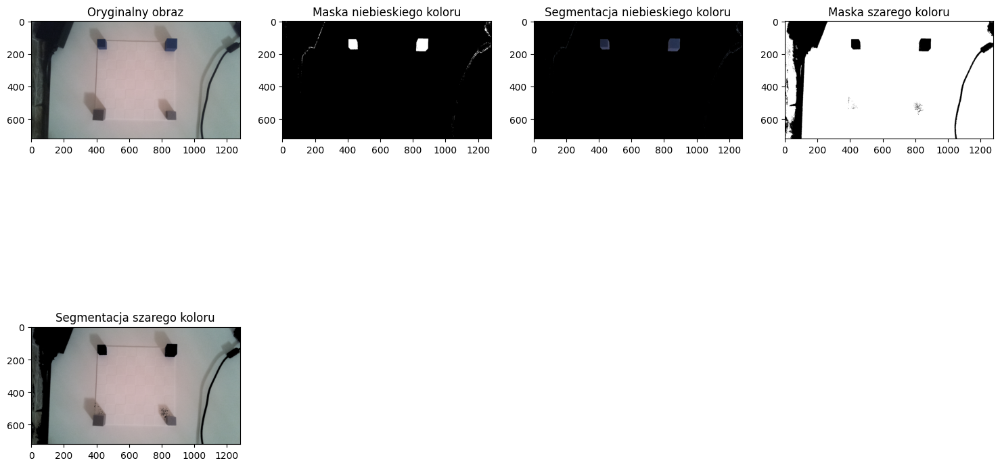

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie1.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Sprawdź zakresy kolorów w obrazie HSV
    hue_min, hue_max = hsv_image[:,:,0].min(), hsv_image[:,:,0].max()
    saturation_min, saturation_max = hsv_image[:,:,1].min(), hsv_image[:,:,1].max()
    value_min, value_max = hsv_image[:,:,2].min(), hsv_image[:,:,2].max()

    print("Zakresy kolorów HSV w obrazie:")
    print(f"Hue min: {hue_min}, max: {hue_max}")
    print(f"Saturation min: {saturation_min}, max: {saturation_max}")
    print(f"Value min: {value_min}, max: {value_max}")

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 50, 50])
    upper_blue = np.array([140, 255, 255])

    lower_gray = np.array([0, 0, 50])
    upper_gray = np.array([180, 50, 255])

    # Utworzenie masek dla poszczególnych kolorów
    mask_blue = cv2.inRange(hsv_image, lower_blue, upper_blue)
    mask_gray = cv2.inRange(hsv_image, lower_gray, upper_gray)

    # Nałożenie masek na obraz
    result_blue = cv2.bitwise_and(image, image, mask=mask_blue)
    result_gray = cv2.bitwise_and(image, image, mask=mask_gray)

    # Wyświetlanie wyników
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 4, 1)
    plt.title('Oryginalny obraz')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    plt.subplot(2, 4, 2)
    plt.title('Maska niebieskiego koloru')
    plt.imshow(mask_blue, cmap='gray')

    plt.subplot(2, 4, 3)
    plt.title('Segmentacja niebieskiego koloru')
    plt.imshow(cv2.cvtColor(result_blue, cv2.COLOR_BGR2RGB))

    plt.subplot(2, 4, 4)
    plt.title('Maska szarego koloru')
    plt.imshow(mask_gray, cmap='gray')

    plt.subplot(2, 4, 5)
    plt.title('Segmentacja szarego koloru')
    plt.imshow(cv2.cvtColor(result_gray, cv2.COLOR_BGR2RGB))

    plt.tight_layout()
    plt.show()


## **2. HSV test2**
Maska i segmentacja plus obrys konturu

Zakresy kolorów HSV w obrazie:
Hue min: 0, max: 179
Saturation min: 0, max: 213
Value min: 10, max: 211


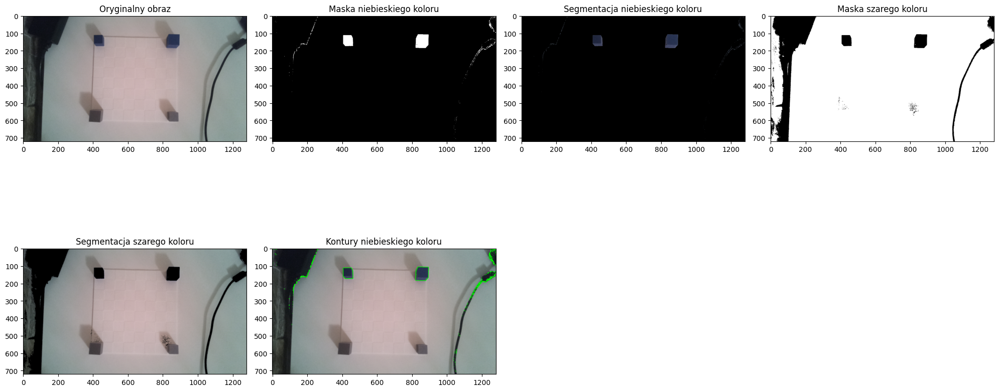

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie1.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Sprawdź zakresy kolorów w obrazie HSV
    hue_min, hue_max = hsv_image[:,:,0].min(), hsv_image[:,:,0].max()
    saturation_min, saturation_max = hsv_image[:,:,1].min(), hsv_image[:,:,1].max()
    value_min, value_max = hsv_image[:,:,2].min(), hsv_image[:,:,2].max()

    print("Zakresy kolorów HSV w obrazie:")
    print(f"Hue min: {hue_min}, max: {hue_max}")
    print(f"Saturation min: {saturation_min}, max: {saturation_max}")
    print(f"Value min: {value_min}, max: {value_max}")

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 50, 50])
    upper_blue = np.array([140, 255, 255])

    lower_gray = np.array([0, 0, 50])
    upper_gray = np.array([180, 50, 255])

    # Utworzenie masek dla poszczególnych kolorów
    mask_blue = cv2.inRange(hsv_image, lower_blue, upper_blue)
    mask_gray = cv2.inRange(hsv_image, lower_gray, upper_gray)

    # Nałożenie masek na obraz
    result_blue = cv2.bitwise_and(image, image, mask=mask_blue)
    result_gray = cv2.bitwise_and(image, image, mask=mask_gray)

    # Znajdowanie konturów na masce koloru niebieskiego
    contours, _ = cv2.findContours(mask_blue, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Kopia oryginalnego obrazu do rysowania konturów
    image_with_contours = image.copy()

    # Rysowanie konturów na obrazie
    cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)  # Zielone kontury

    # Wyświetlanie wyników
    plt.figure(figsize=(20, 10))
    plt.subplot(2, 4, 1)
    plt.title('Oryginalny obraz')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    plt.subplot(2, 4, 2)
    plt.title('Maska niebieskiego koloru')
    plt.imshow(mask_blue, cmap='gray')

    plt.subplot(2, 4, 3)
    plt.title('Segmentacja niebieskiego koloru')
    plt.imshow(cv2.cvtColor(result_blue, cv2.COLOR_BGR2RGB))

    plt.subplot(2, 4, 4)
    plt.title('Maska szarego koloru')
    plt.imshow(mask_gray, cmap='gray')

    plt.subplot(2, 4, 5)
    plt.title('Segmentacja szarego koloru')
    plt.imshow(cv2.cvtColor(result_gray, cv2.COLOR_BGR2RGB))

    plt.subplot(2, 4, 6)
    plt.title('Kontury niebieskiego koloru')
    plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))

    plt.tight_layout()
    plt.show()


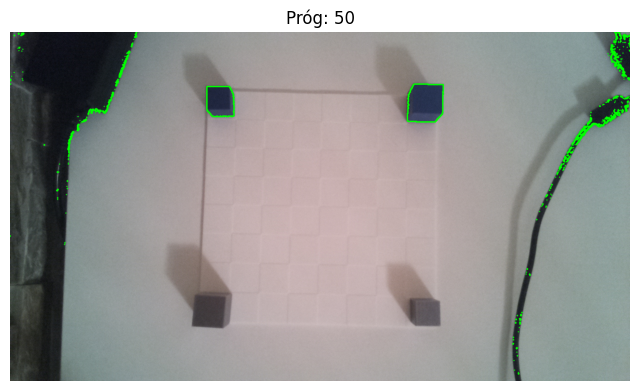

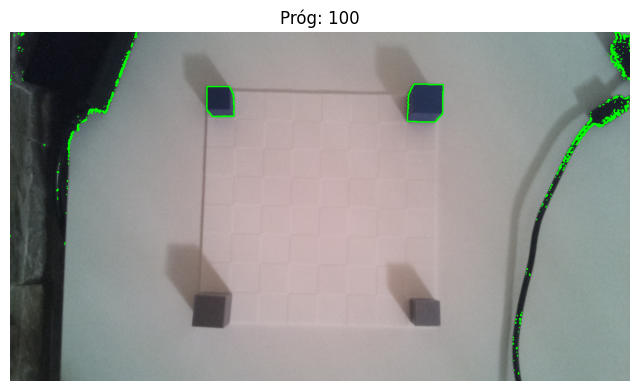

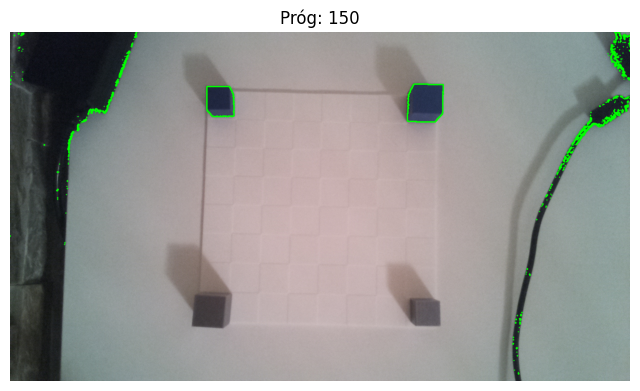

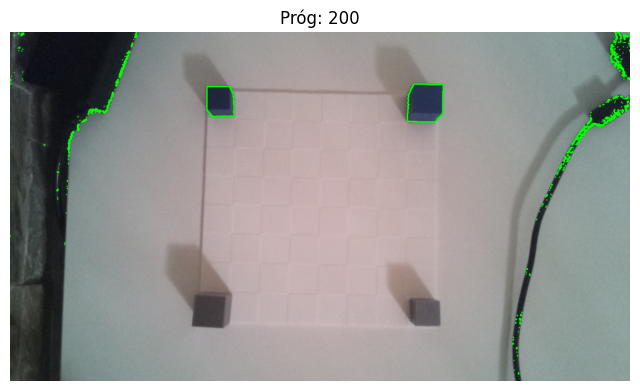

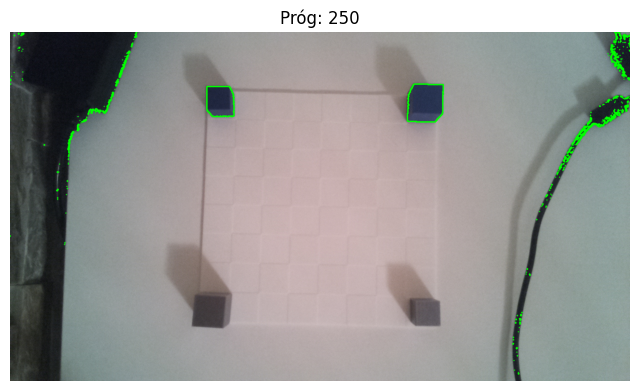

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie1.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresu koloru niebieskiego w przestrzeni HSV
    lower_blue = np.array([100, 50, 50])
    upper_blue = np.array([140, 255, 255])

    # Wykrywanie konturów na masce koloru niebieskiego
    for threshold in range(50, 256, 50):
        mask_blue = cv2.inRange(hsv_image, lower_blue, upper_blue)
        mask_blue_thresholded = cv2.threshold(mask_blue, threshold, 255, cv2.THRESH_BINARY)[1]
        contours, _ = cv2.findContours(mask_blue_thresholded, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

        # Rysowanie konturów na oryginalnym obrazie
        image_with_contours = image.copy()
        cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)

        # Wyświetlanie wyników
        plt.figure(figsize=(8, 6))
        plt.title(f'Próg: {threshold}')
        plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()


## **3. Rozwiązanie z filtrowaniem szumów (dylatacja i erozja)**

rozne zakresy niebieskiego

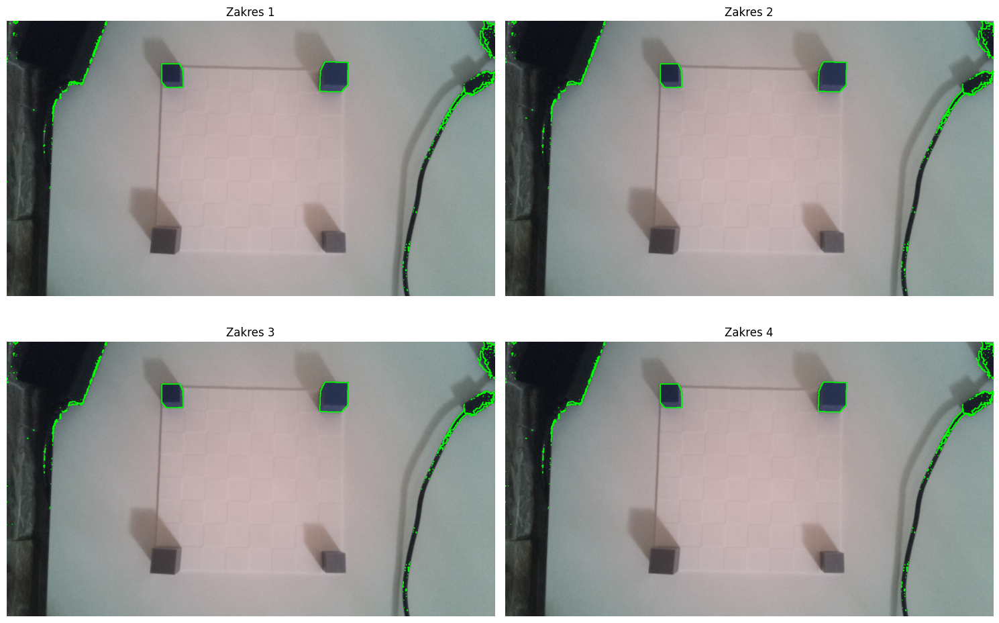

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Wczytaj obraz
image = cv2.imread('/content/images/images/train/zdjecie1.jpg')

# Konwertuj obraz do przestrzeni kolorów HSV
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Zakresy koloru niebieskiego w przestrzeni HSV
blue_ranges = [
    ((100, 50, 50), (140, 255, 255)),
    ((90, 50, 50), (150, 255, 255)),
    ((80, 50, 50), (160, 255, 255)),
    ((70, 50, 50), (170, 255, 255)),
]

# Wielkość jądra dla dylatacji i erozji
kernel_size = (5, 5)

# Wyświetlanie wyników
plt.figure(figsize=(15, 10))

for i, (lower_blue, upper_blue) in enumerate(blue_ranges, 1):
    # Twórz maskę dla koloru niebieskiego
    mask_blue = cv2.inRange(hsv_image, np.array(lower_blue), np.array(upper_blue))

    # Filtrowanie szumów za pomocą dylatacji i erozji
    kernel = np.ones(kernel_size, np.uint8)
    mask_blue_filtered = cv2.dilate(mask_blue, kernel, iterations=1)
    mask_blue_filtered = cv2.erode(mask_blue_filtered, kernel, iterations=1)

    # Wykrywanie konturów na masce koloru niebieskiego
    contours, _ = cv2.findContours(mask_blue_filtered, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Rysowanie konturów na oryginalnym obrazie
    image_with_contours = image.copy()
    cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)

    # Wyświetlanie wyników
    plt.subplot(2, 2, i)
    plt.title(f'Zakres {i}')
    plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
    plt.axis('off')

plt.tight_layout()
plt.show()


## **3.1. Rozwiązanie z filtrowaniem szumów (dylatacja i erozja)**

rozne zakresy szumów

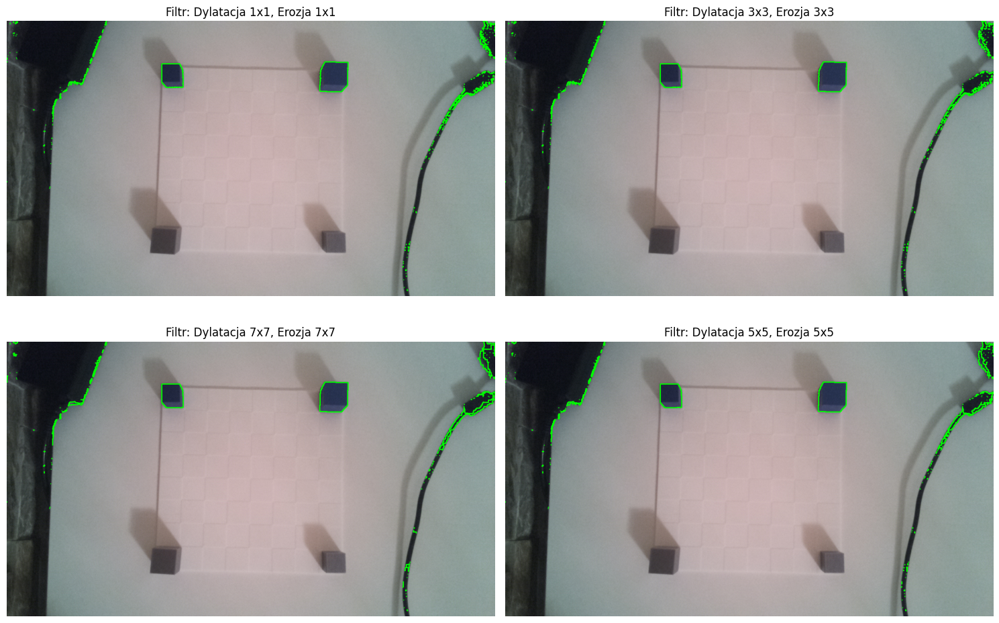

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Wczytaj obraz
image = cv2.imread('/content/images/images/train/zdjecie1.jpg')

# Konwertuj obraz do przestrzeni kolorów HSV
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Podstawowy zakres koloru niebieskiego w przestrzeni HSV
lower_blue_base = np.array([100, 50, 50])
upper_blue_base = np.array([140, 255, 255])

# Definiuj różne zakresy dla szumów
noise_ranges = [
    (1, 1),   # Bez filtra (oryginalny obraz)
    (3, 3),   # Dylatacja i erozja z mniejszym jądrem
    (7, 7),   # Dylatacja i erozja z większym jądrem
    (5, 5),   # Dylatacja i erozja z jądrem o średniej wielkości
]

# Wyświetlanie wyników
plt.figure(figsize=(15, 10))

for i, (dilate_size, erode_size) in enumerate(noise_ranges, 1):
    # Twórz maskę dla koloru niebieskiego
    mask_blue = cv2.inRange(hsv_image, lower_blue_base, upper_blue_base)

    # Filtrowanie szumów za pomocą dylatacji i erozji
    kernel_dilate = np.ones((dilate_size, dilate_size), np.uint8)
    kernel_erode = np.ones((erode_size, erode_size), np.uint8)
    mask_blue_filtered = cv2.dilate(mask_blue, kernel_dilate, iterations=1)
    mask_blue_filtered = cv2.erode(mask_blue_filtered, kernel_erode, iterations=1)

    # Wykrywanie konturów na masce koloru niebieskiego
    contours, _ = cv2.findContours(mask_blue_filtered, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Rysowanie konturów na oryginalnym obrazie
    image_with_contours = image.copy()
    cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)

    # Wyświetlanie wyników
    plt.subplot(2, 2, i)
    plt.title(f'Filtr: Dylatacja {dilate_size}x{dilate_size}, Erozja {erode_size}x{erode_size}')
    plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
    plt.axis('off')

plt.tight_layout()
plt.show()


## **4. Rozwiązanie z filtrowaniem szumów (mediana)**


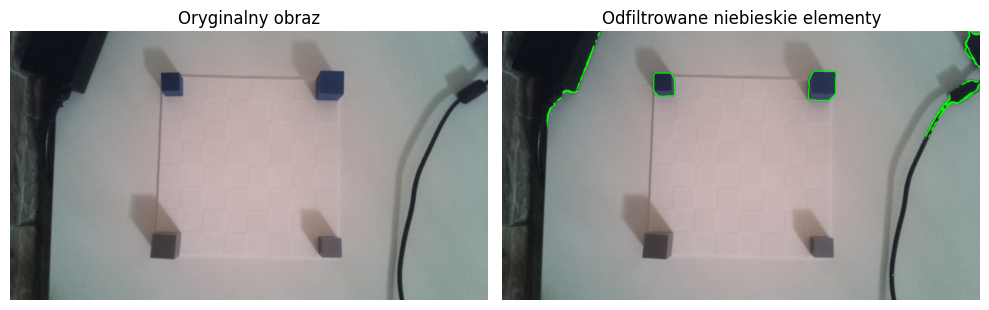

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Wczytaj obraz
image = cv2.imread('/content/images/images/train/zdjecie1.jpg')

# Konwertuj obraz do przestrzeni kolorów HSV
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Filtracja medianowa dla redukcji szumów
median_filtered = cv2.medianBlur(hsv_image, 9)  # Rozmiar filtra: 5x5

# Podstawowy zakres koloru niebieskiego w przestrzeni HSV
lower_blue_base = np.array([100, 50, 50])
upper_blue_base = np.array([140, 255, 255])

# Twórz maskę dla koloru niebieskiego
mask_blue = cv2.inRange(median_filtered, lower_blue_base, upper_blue_base)

# Wykrywanie konturów na masce koloru niebieskiego
contours, _ = cv2.findContours(mask_blue, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Rysowanie konturów na oryginalnym obrazie
image_with_contours = image.copy()
cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)

# Wyświetlanie wyników
plt.figure(figsize=(10, 8))
plt.subplot(1, 2, 1)
plt.title('Oryginalny obraz')
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Odfiltrowane niebieskie elementy')
plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()


## **5. Rozwiązanie z filtrowaniem gaussowskim**

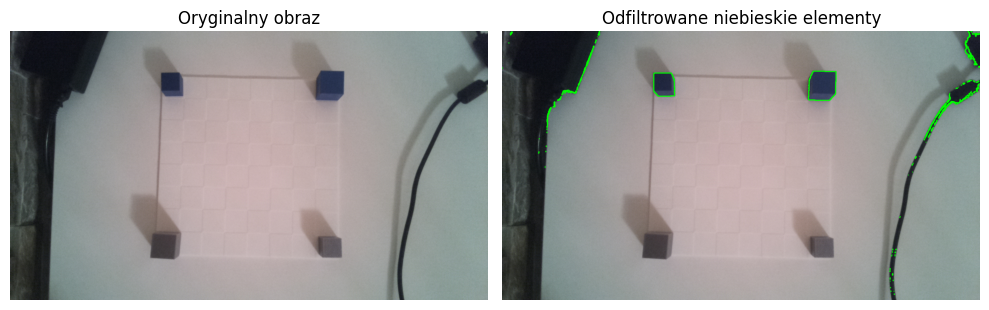

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Wczytaj obraz
image = cv2.imread('/content/images/images/train/zdjecie1.jpg')

# Konwertuj obraz do przestrzeni kolorów HSV
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Filtracja Gaussowska dla redukcji szumów
gaussian_filtered = cv2.GaussianBlur(hsv_image, (5, 5), 0)  # Rozmiar filtra: 5x5

# Podstawowy zakres koloru niebieskiego w przestrzeni HSV
lower_blue_base = np.array([100, 50, 50])
upper_blue_base = np.array([140, 255, 255])

# Twórz maskę dla koloru niebieskiego
mask_blue = cv2.inRange(gaussian_filtered, lower_blue_base, upper_blue_base)

# Wykrywanie konturów na masce koloru niebieskiego
contours, _ = cv2.findContours(mask_blue, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Rysowanie konturów na oryginalnym obrazie
image_with_contours = image.copy()
cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)

# Wyświetlanie wyników
plt.figure(figsize=(10, 8))
plt.subplot(1, 2, 1)
plt.title('Oryginalny obraz')
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Odfiltrowane niebieskie elementy')
plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()


## **6. Rozwiązanie z segmentacją adaptacyjną**

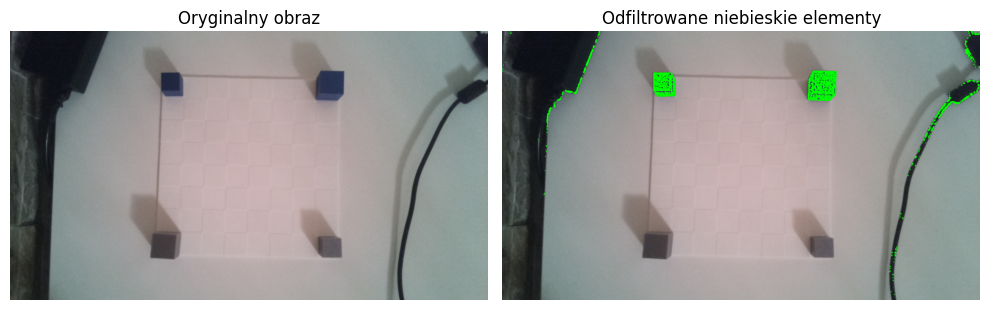

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Wczytaj obraz
image = cv2.imread('/content/images/images/train/zdjecie1.jpg')

# Konwertuj obraz do przestrzeni kolorów HSV
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Zastosuj segmentację adaptacyjną do uzyskania maski
adaptive_mask = cv2.adaptiveThreshold(hsv_image[:,:,2], 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 11, 2)

# Podstawowy zakres koloru niebieskiego w przestrzeni HSV
lower_blue_base = np.array([100, 50, 50])
upper_blue_base = np.array([140, 255, 255])

# Twórz maskę dla koloru niebieskiego
mask_blue = cv2.inRange(hsv_image, lower_blue_base, upper_blue_base)

# Połącz maskę z segmentacją adaptacyjną
mask_combined = cv2.bitwise_and(mask_blue, adaptive_mask)

# Wykrywanie konturów na połączonej masce
contours, _ = cv2.findContours(mask_combined, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Rysowanie konturów na oryginalnym obrazie
image_with_contours = image.copy()
cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)

# Wyświetlanie wyników
plt.figure(figsize=(10, 8))
plt.subplot(1, 2, 1)
plt.title('Oryginalny obraz')
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Odfiltrowane niebieskie elementy')
plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()


## **7. Rozwiązanie z filtracją kontekstową**

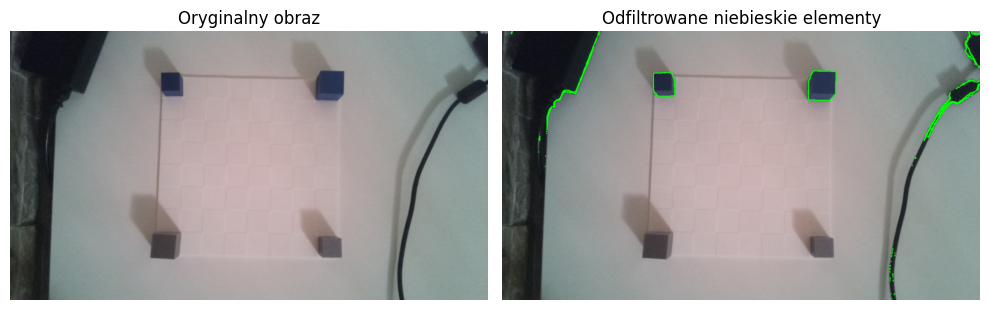

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Wczytaj obraz
image = cv2.imread('/content/images/images/train/zdjecie1.jpg')

# Konwertuj obraz do przestrzeni kolorów HSV
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Zastosuj filtrację bilateralną do uzyskania wygładzonego obrazu
bilateral_filtered = cv2.bilateralFilter(hsv_image, 9, 75, 75)

# Podstawowy zakres koloru niebieskiego w przestrzeni HSV
lower_blue_base = np.array([100, 50, 50])
upper_blue_base = np.array([140, 255, 255])

# Twórz maskę dla koloru niebieskiego
mask_blue = cv2.inRange(bilateral_filtered, lower_blue_base, upper_blue_base)

# Wykrywanie konturów na masce koloru niebieskiego
contours, _ = cv2.findContours(mask_blue, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Rysowanie konturów na oryginalnym obrazie
image_with_contours = image.copy()
cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)

# Wyświetlanie wyników
plt.figure(figsize=(10, 8))
plt.subplot(1, 2, 1)
plt.title('Oryginalny obraz')
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Odfiltrowane niebieskie elementy')
plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()


## **8. Dodanie algorytmu Canniego**

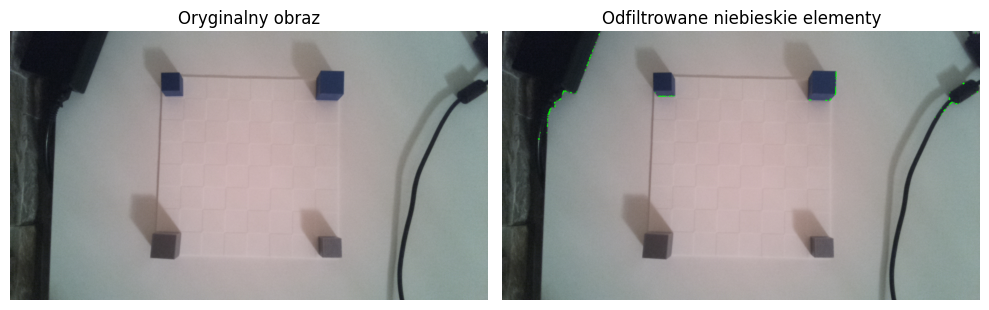

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Wczytaj obraz
image = cv2.imread('/content/images/images/train/zdjecie1.jpg')

# Konwertuj obraz do przestrzeni kolorów HSV
hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

# Zastosuj algorytm Canny'ego do uzyskania krawędzi obiektów
edges = cv2.Canny(hsv_image[:,:,2], 100, 200)

# Podstawowy zakres koloru niebieskiego w przestrzeni HSV
lower_blue_base = np.array([100, 50, 50])
upper_blue_base = np.array([140, 255, 255])

# Twórz maskę dla koloru niebieskiego
mask_blue = cv2.inRange(hsv_image, lower_blue_base, upper_blue_base)

# Połącz maskę z krawędziami
mask_combined = cv2.bitwise_and(mask_blue, edges)

# Wykrywanie konturów na połączonej masce
contours, _ = cv2.findContours(mask_combined, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Rysowanie konturów na oryginalnym obrazie
image_with_contours = image.copy()
cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)

# Wyświetlanie wyników
plt.figure(figsize=(10, 8))
plt.subplot(1, 2, 1)
plt.title('Oryginalny obraz')
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Odfiltrowane niebieskie elementy')
plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()


## **9. Wykrywanie powierzchni prostopadłych - transformacja Hougha**

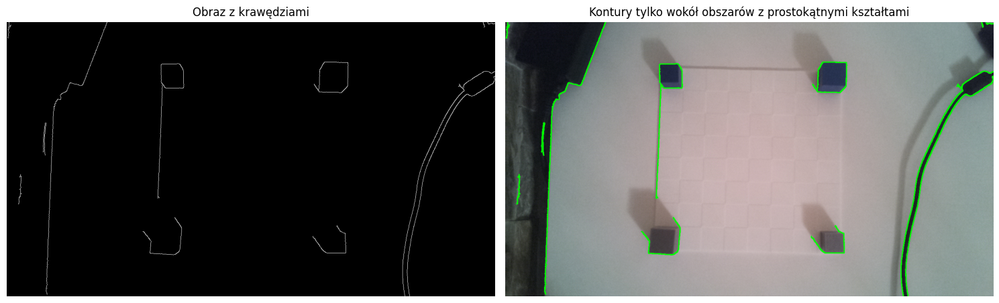

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie1.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do skali szarości
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Zastosuj detekcję krawędzi
    edges = cv2.Canny(gray_image, 50, 150)

    # Wykrywanie prostokątnych kształtów za pomocą transformacji Hougha
    lines = cv2.HoughLinesP(edges, 1, np.pi/180, threshold=100, minLineLength=100, maxLineGap=10)

    # Inicjalizacja pustej listy dla prostokątnych kształtów
    rectangles = []

    # Pętla po wszystkich wykrytych liniach
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            # Sprawdź czy linia jest wystarczająco długa (linie krótsze będą ignorowane)
            length = np.sqrt((x2 - x1) ** 2 + (y2 - y1) ** 2)
            if length > 50:
                rectangles.append(line)

    # Rysowanie konturów tylko dla obszarów z prostokątnymi kształtami
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_contours = image.copy()
    cv2.drawContours(image_with_contours, contours, -1, (0, 255, 0), 2)

    # Wyświetlanie wyników
    plt.figure(figsize=(15, 10))
    plt.subplot(1, 2, 1)
    plt.title('Obraz z krawędziami')
    plt.imshow(edges, cmap='gray')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Kontury tylko wokół obszarów z prostokątnymi kształtami')
    plt.imshow(cv2.cvtColor(image_with_contours, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.tight_layout()
    plt.show()


## **10. Określenie zakresów dla poszczególnych kolorów**

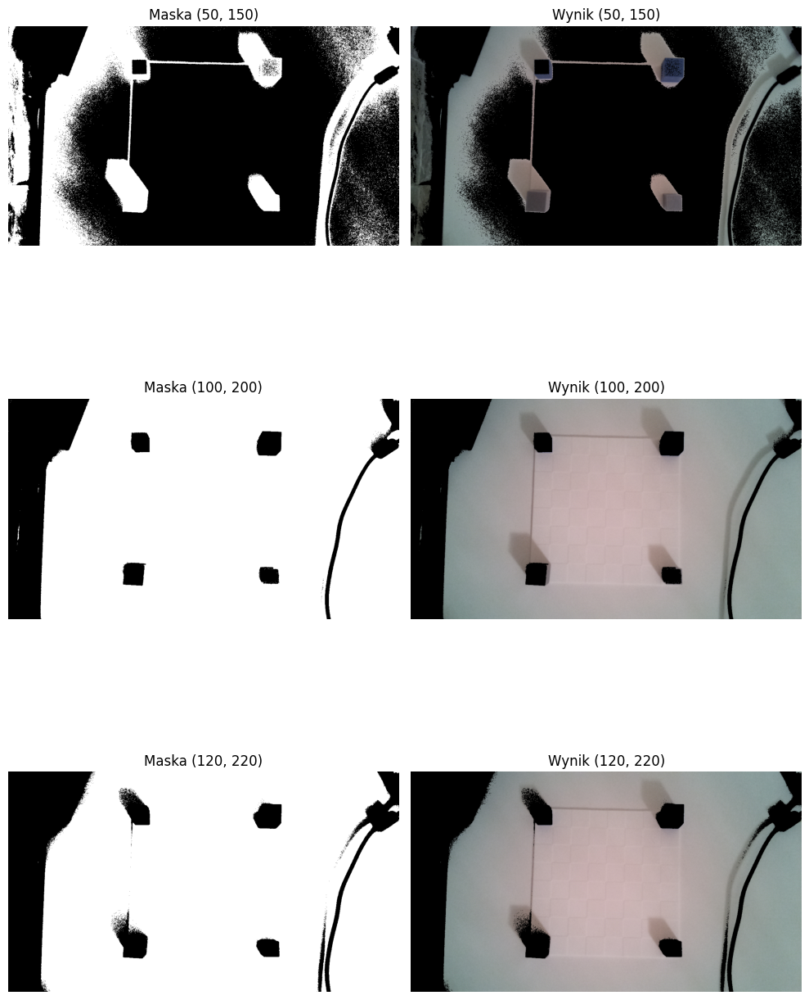

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie1.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do odcieni szarości
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Definiowanie różnych zestawów progów dla koloru szarego
    gray_thresholds = [
        (50, 150),  # Przykład zakresu szarego
        (100, 200),  # Inny przykład zakresu szarego
        (120, 220)   # Jeszcze inny przykład zakresu szarego
    ]

    # Przetwarzanie obrazu przy użyciu różnych progów
    fig, axes = plt.subplots(len(gray_thresholds), 2, figsize=(10, 5 * len(gray_thresholds)))
    for idx, (lower, upper) in enumerate(gray_thresholds):
        # Utworzenie maski na podstawie zakresów szarości
        mask = cv2.inRange(gray_image, lower, upper)
        result = cv2.bitwise_and(image, image, mask=mask)

        # Wyświetlenie maski i wynikowego obrazu
        axes[idx, 0].imshow(mask, cmap='gray')
        axes[idx, 0].set_title(f'Maska ({lower}, {upper})')
        axes[idx, 0].axis('off')

        axes[idx, 1].imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
        axes[idx, 1].set_title(f'Wynik ({lower}, {upper})')
        axes[idx, 1].axis('off')

    plt.tight_layout()
    plt.show()


## **=============TEST 27.06.2024 =============**

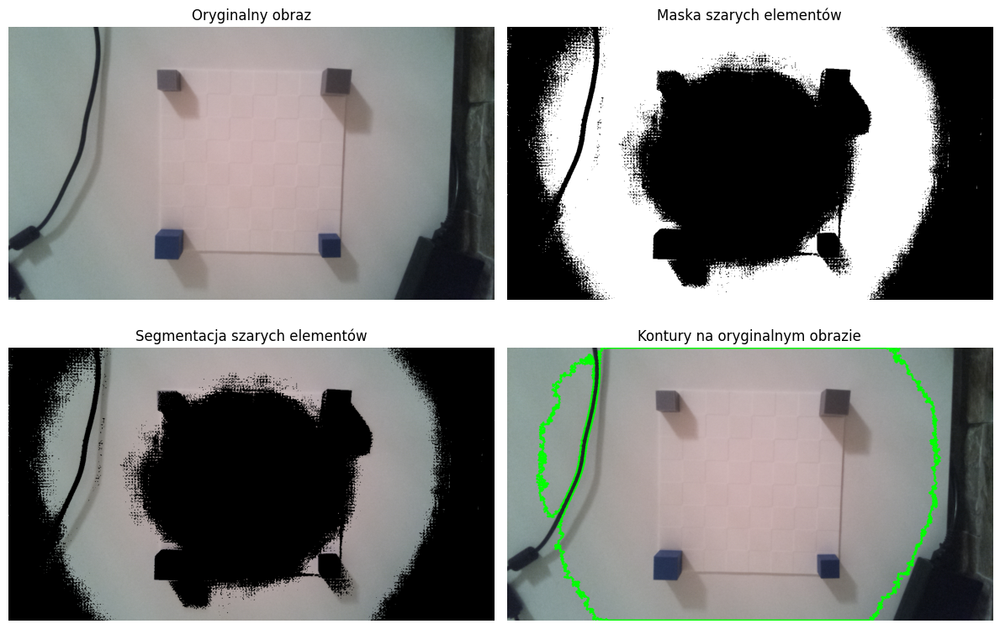

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie2.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Zakresy kolorów szarego dla detekcji
    lower_gray = np.array([0, 0, 100])
    upper_gray = np.array([179, 20, 220])

    # Utwórz maskę dla szarych elementów
    mask_gray = cv2.inRange(hsv_image, lower_gray, upper_gray)

    # Zastosuj maskę i uzyskaj wynik
    result_gray = cv2.bitwise_and(image, image, mask=mask_gray)

    # Znajdź kontury
    contours, _ = cv2.findContours(mask_gray, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie konturów
    filtered_contours = []
    min_contour_area_gray = 500  # Minimalna powierzchnia konturu, aby go zachować
    aspect_ratio_threshold = 0.2  # Minimalny stosunek wysokości do szerokości

    for cnt in contours:
        area = cv2.contourArea(cnt)
        if area >= min_contour_area_gray:
            x, y, w, h = cv2.boundingRect(cnt)
            aspect_ratio = float(h) / w
            if aspect_ratio > aspect_ratio_threshold:
                filtered_contours.append(cnt)

    # Rysowanie konturów na oryginalnym obrazie
    contoured_image_gray = image.copy()
    cv2.drawContours(contoured_image_gray, filtered_contours, -1, (0, 255, 0), 3)

    # Wyświetlenie wyników
    plt.figure(figsize=(12, 8))

    plt.subplot(2, 2, 1)
    plt.title('Oryginalny obraz')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.title('Maska szarych elementów')
    plt.imshow(mask_gray, cmap='gray')
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.title('Segmentacja szarych elementów')
    plt.imshow(cv2.cvtColor(result_gray, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.title('Kontury na oryginalnym obrazie')
    plt.imshow(cv2.cvtColor(contoured_image_gray, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.tight_layout()
    plt.show()


## **DODATEK - POPRAWNE WYKRYWANIE ELEMENTÓW - NIEBIESKI**

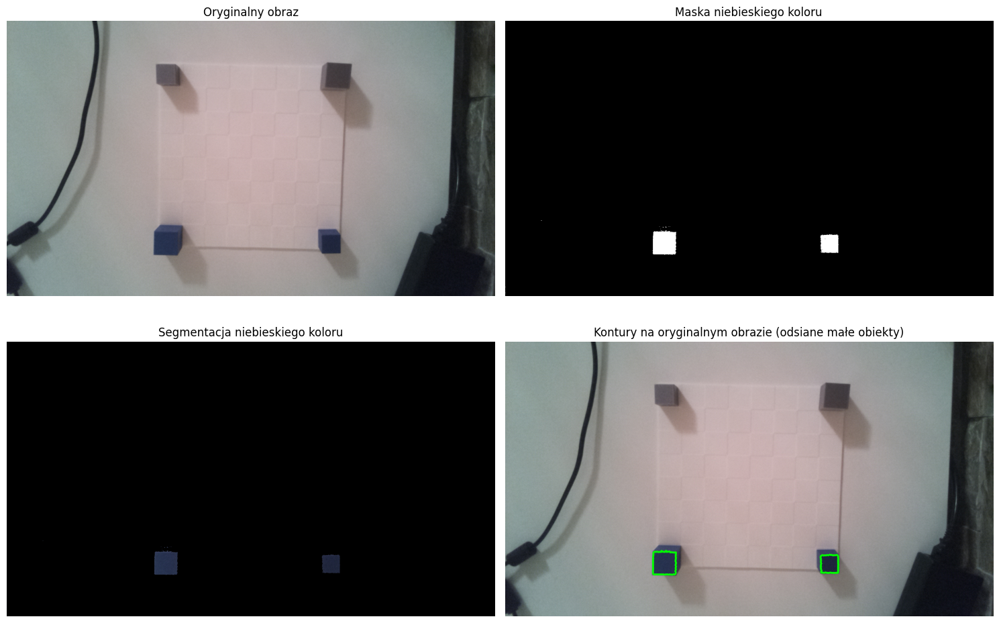

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie2.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(image, image, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Rysowanie konturów na oryginalnym obrazie
    contoured_image = image.copy()
    cv2.drawContours(contoured_image, filtered_contours, -1, (0, 255, 0), 3)  # Rysowanie konturów kolorem zielonym

    # Wyświetlanie wyników
    plt.figure(figsize=(15, 10))

    plt.subplot(2, 2, 1)
    plt.title('Oryginalny obraz')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(2, 2, 2)
    plt.title('Maska niebieskiego koloru')
    plt.imshow(mask, cmap='gray')
    plt.axis('off')

    plt.subplot(2, 2, 3)
    plt.title('Segmentacja niebieskiego koloru')
    plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(2, 2, 4)
    plt.title('Kontury na oryginalnym obrazie (odsiane małe obiekty)')
    plt.imshow(cv2.cvtColor(contoured_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.tight_layout()
    plt.show()


## **DODATEK - WYKRYWANIE ELEMENTÓW - SZARY**

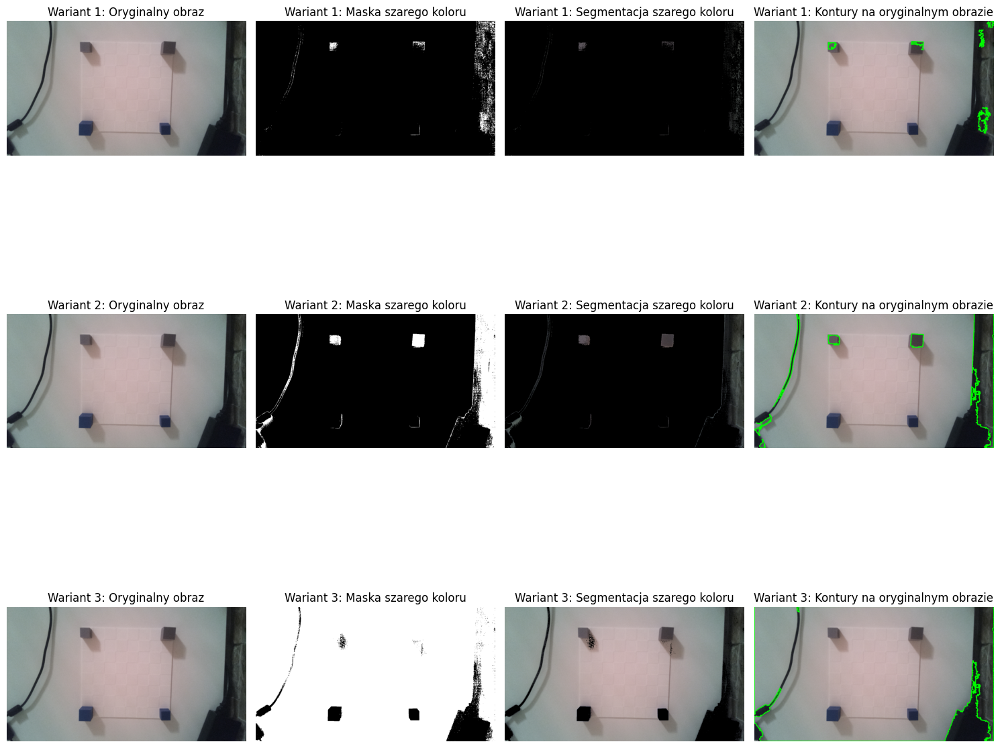

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie2.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Wariant 1: Zakresy dla szarego pod światło dziennie
    lower_gray_1 = np.array([0, 0, 0])
    upper_gray_1 = np.array([179, 20, 100])

    # Wariant 2: Zakresy dla szarego w warunkach sztucznego oświetlenia
    lower_gray_2 = np.array([0, 0, 0])
    upper_gray_2 = np.array([179, 50, 100])

    # Wariant 3: Szeroki zakres dla szarego (uniwersalny)
    lower_gray_3 = np.array([0, 0, 0])
    upper_gray_3 = np.array([179, 50, 255])

    # Utwórz maski dla każdego wariantu
    mask_gray_1 = cv2.inRange(hsv_image, lower_gray_1, upper_gray_1)
    mask_gray_2 = cv2.inRange(hsv_image, lower_gray_2, upper_gray_2)
    mask_gray_3 = cv2.inRange(hsv_image, lower_gray_3, upper_gray_3)

    # Zastosuj maski i uzyskaj wyniki
    result_gray_1 = cv2.bitwise_and(image, image, mask=mask_gray_1)
    result_gray_2 = cv2.bitwise_and(image, image, mask=mask_gray_2)
    result_gray_3 = cv2.bitwise_and(image, image, mask=mask_gray_3)

    # Znajdź kontury dla każdego wariantu
    contours_gray_1, _ = cv2.findContours(mask_gray_1, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_gray_2, _ = cv2.findContours(mask_gray_2, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours_gray_3, _ = cv2.findContours(mask_gray_3, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area_gray = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours_gray_1 = [cnt for cnt in contours_gray_1 if cv2.contourArea(cnt) >= min_contour_area_gray]
    filtered_contours_gray_2 = [cnt for cnt in contours_gray_2 if cv2.contourArea(cnt) >= min_contour_area_gray]
    filtered_contours_gray_3 = [cnt for cnt in contours_gray_3 if cv2.contourArea(cnt) >= min_contour_area_gray]

    # Rysowanie konturów na oryginalnym obrazie dla każdego wariantu
    contoured_image_gray_1 = image.copy()
    contoured_image_gray_2 = image.copy()
    contoured_image_gray_3 = image.copy()

    cv2.drawContours(contoured_image_gray_1, filtered_contours_gray_1, -1, (0, 255, 0), 3)
    cv2.drawContours(contoured_image_gray_2, filtered_contours_gray_2, -1, (0, 255, 0), 3)
    cv2.drawContours(contoured_image_gray_3, filtered_contours_gray_3, -1, (0, 255, 0), 3)

    # Wyświetlenie wyników
    plt.figure(figsize=(15, 15))

    plt.subplot(3, 4, 1)
    plt.title('Wariant 1: Oryginalny obraz')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(3, 4, 2)
    plt.title('Wariant 1: Maska szarego koloru')
    plt.imshow(mask_gray_1, cmap='gray')
    plt.axis('off')

    plt.subplot(3, 4, 3)
    plt.title('Wariant 1: Segmentacja szarego koloru')
    plt.imshow(cv2.cvtColor(result_gray_1, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(3, 4, 4)
    plt.title('Wariant 1: Kontury na oryginalnym obrazie')
    plt.imshow(cv2.cvtColor(contoured_image_gray_1, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(3, 4, 5)
    plt.title('Wariant 2: Oryginalny obraz')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(3, 4, 6)
    plt.title('Wariant 2: Maska szarego koloru')
    plt.imshow(mask_gray_2, cmap='gray')
    plt.axis('off')

    plt.subplot(3, 4, 7)
    plt.title('Wariant 2: Segmentacja szarego koloru')
    plt.imshow(cv2.cvtColor(result_gray_2, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(3, 4, 8)
    plt.title('Wariant 2: Kontury na oryginalnym obrazie')
    plt.imshow(cv2.cvtColor(contoured_image_gray_2, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(3, 4, 9)
    plt.title('Wariant 3: Oryginalny obraz')
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(3, 4, 10)
    plt.title('Wariant 3: Maska szarego koloru')
    plt.imshow(mask_gray_3, cmap='gray')
    plt.axis('off')

    plt.subplot(3, 4, 11)
    plt.title('Wariant 3: Segmentacja szarego koloru')
    plt.imshow(cv2.cvtColor(result_gray_3, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.subplot(3, 4, 12)
    plt.title('Wariant 3: Kontury na oryginalnym obrazie')
    plt.imshow(cv2.cvtColor(contoured_image_gray_3, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# **26.06.2024 - Testy przekształceń obrazu**

## **1. Szacowanie odległości pomiędzy wykrytymi elementami**

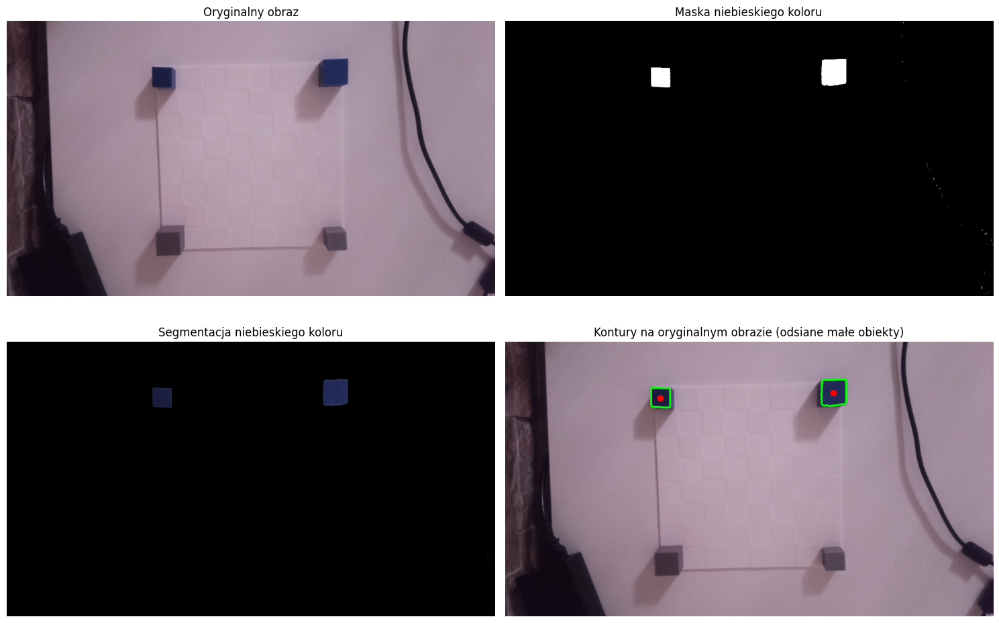

Odległość między środkami elementów w pikselach: 454.22
Szacowana odległość rzeczywista między elementami: 347.46


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie10.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(image, image, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Rysowanie konturów na oryginalnym obrazie
    contoured_image = image.copy()
    cv2.drawContours(contoured_image, filtered_contours, -1, (0, 255, 0), 3)  # Rysowanie konturów kolorem zielonym

    # Obliczanie środków elementów i ich powierzchni
    centroids = []
    areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids.append((cX, cY))
            areas.append(cv2.contourArea(cnt))
        else:
            centroids.append((0, 0))
            areas.append(0)

    # Zakładamy, że mniejszy element ma rzeczywiste wymiary 1x1 a większy 2x2
    if len(areas) == 2:
        min_area = min(areas)
        max_area = max(areas)
        scale_factor = np.sqrt(max_area / min_area)  # Stosunek skalowania

        # Odległość między środkami elementów w pikselach
        distance_pixels = np.linalg.norm(np.array(centroids[0]) - np.array(centroids[1]))

        # Skalowanie odległości na podstawie rzeczywistych wymiarów
        distance_real = distance_pixels / scale_factor

        # Wyświetlanie wyników
        plt.figure(figsize=(15, 10))

        plt.subplot(2, 2, 1)
        plt.title('Oryginalny obraz')
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.axis('off')

        plt.subplot(2, 2, 2)
        plt.title('Maska niebieskiego koloru')
        plt.imshow(mask, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 2, 3)
        plt.title('Segmentacja niebieskiego koloru')
        plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
        plt.axis('off')

        plt.subplot(2, 2, 4)
        plt.title('Kontury na oryginalnym obrazie (odsiane małe obiekty)')
        plt.imshow(cv2.cvtColor(contoured_image, cv2.COLOR_BGR2RGB))
        for centroid in centroids:
            plt.scatter(*centroid, color='red')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

        print(f"Odległość między środkami elementów w pikselach: {distance_pixels:.2f}")
        print(f"Szacowana odległość rzeczywista między elementami: {distance_real:.2f}")

    else:
        print("Nie wykryto dokładnie dwóch elementów na obrazie")


# **27.06.2024 - Dodawanie etykiet wokół wykrytych elementów**

## **1. Dodawanie etykiet wykrytych elementów**

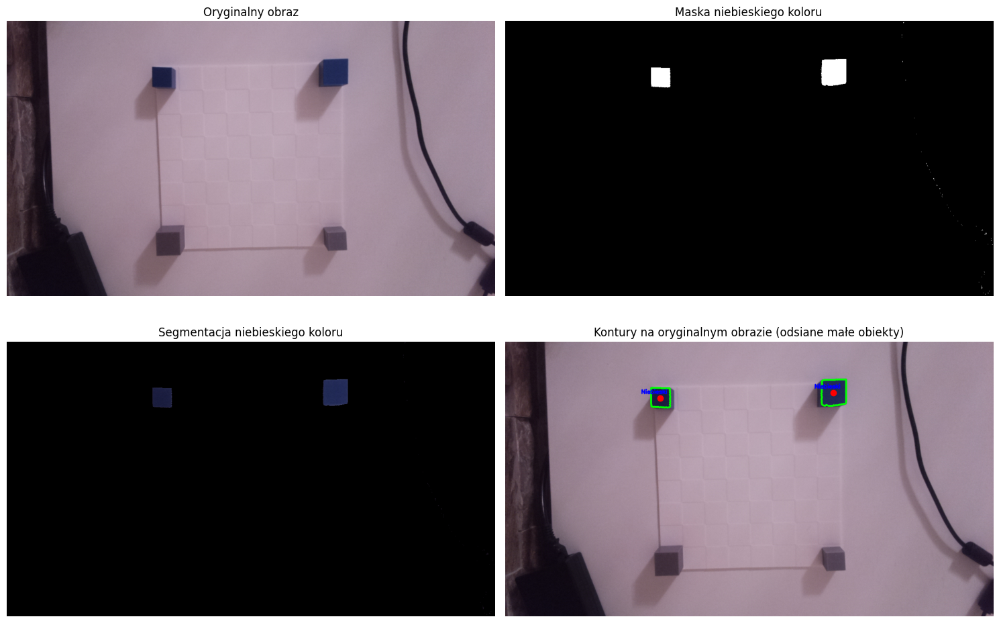

Odległość między środkami elementów w pikselach: 454.22
Szacowana odległość rzeczywista między elementami: 347.46


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie10.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(image, image, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Rysowanie konturów na oryginalnym obrazie
    contoured_image = image.copy()
    cv2.drawContours(contoured_image, filtered_contours, -1, (0, 255, 0), 3)  # Rysowanie konturów kolorem zielonym

    # Obliczanie środków elementów i ich powierzchni
    centroids = []
    areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids.append((cX, cY))
            areas.append(cv2.contourArea(cnt))
            # Dodanie etykiety z kolorem
            cv2.putText(contoured_image, 'Niebieski', (cX - 50, cY - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
        else:
            centroids.append((0, 0))
            areas.append(0)

    # Zakładamy, że mniejszy element ma rzeczywiste wymiary 1x1 a większy 2x2
    if len(areas) == 2:
        min_area = min(areas)
        max_area = max(areas)
        scale_factor = np.sqrt(max_area / min_area)  # Stosunek skalowania

        # Odległość między środkami elementów w pikselach
        distance_pixels = np.linalg.norm(np.array(centroids[0]) - np.array(centroids[1]))

        # Skalowanie odległości na podstawie rzeczywistych wymiarów
        distance_real = distance_pixels / scale_factor

        # Wyświetlanie wyników
        plt.figure(figsize=(15, 10))

        plt.subplot(2, 2, 1)
        plt.title('Oryginalny obraz')
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.axis('off')

        plt.subplot(2, 2, 2)
        plt.title('Maska niebieskiego koloru')
        plt.imshow(mask, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 2, 3)
        plt.title('Segmentacja niebieskiego koloru')
        plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
        plt.axis('off')

        plt.subplot(2, 2, 4)
        plt.title('Kontury na oryginalnym obrazie (odsiane małe obiekty)')
        plt.imshow(cv2.cvtColor(contoured_image, cv2.COLOR_BGR2RGB))
        for centroid in centroids:
            plt.scatter(*centroid, color='red')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

        print(f"Odległość między środkami elementów w pikselach: {distance_pixels:.2f}")
        print(f"Szacowana odległość rzeczywista między elementami: {distance_real:.2f}")

    else:
        print("Nie wykryto dokładnie dwóch elementów na obrazie")


## **2. Dodawanie linii łączącej środki wykrytych elementów**

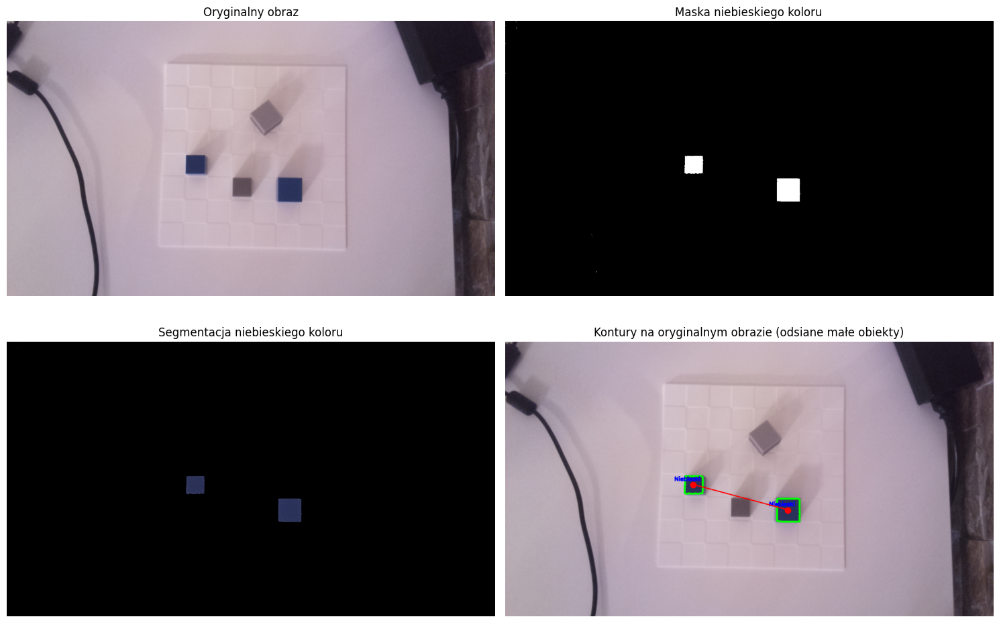

Odległość między środkami elementów w pikselach: 256.63
Szacowana odległość rzeczywista między elementami: 198.26


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Ścieżka do obrazu
image_path = '/content/images/images/train/zdjecie11.jpg'

# Wczytaj obraz
image = cv2.imread(image_path)

# Sprawdź czy obraz został wczytany poprawnie
if image is None:
    print("Nie udało się wczytać obrazu")
else:
    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(image, image, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Rysowanie konturów na oryginalnym obrazie
    contoured_image = image.copy()
    cv2.drawContours(contoured_image, filtered_contours, -1, (0, 255, 0), 3)  # Rysowanie konturów kolorem zielonym

    # Obliczanie środków elementów i ich powierzchni
    centroids = []
    areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids.append((cX, cY))
            areas.append(cv2.contourArea(cnt))
            # Dodanie etykiety z kolorem
            cv2.putText(contoured_image, 'Niebieski', (cX - 50, cY - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
        else:
            centroids.append((0, 0))
            areas.append(0)

    # Zakładamy, że mniejszy element ma rzeczywiste wymiary 1x1 a większy 2x2
    if len(areas) == 2:
        min_area = min(areas)
        max_area = max(areas)
        scale_factor = np.sqrt(max_area / min_area)  # Stosunek skalowania

        # Odległość między środkami elementów w pikselach
        distance_pixels = np.linalg.norm(np.array(centroids[0]) - np.array(centroids[1]))

        # Skalowanie odległości na podstawie rzeczywistych wymiarów
        distance_real = distance_pixels / scale_factor

        # Rysowanie linii między środkami elementów
        cv2.line(contoured_image, centroids[0], centroids[1], (0, 0, 255), 2)  # Czerwona linia

        # Wyświetlanie wyników
        plt.figure(figsize=(15, 10))

        plt.subplot(2, 2, 1)
        plt.title('Oryginalny obraz')
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        plt.axis('off')

        plt.subplot(2, 2, 2)
        plt.title('Maska niebieskiego koloru')
        plt.imshow(mask, cmap='gray')
        plt.axis('off')

        plt.subplot(2, 2, 3)
        plt.title('Segmentacja niebieskiego koloru')
        plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
        plt.axis('off')

        plt.subplot(2, 2, 4)
        plt.title('Kontury na oryginalnym obrazie (odsiane małe obiekty)')
        plt.imshow(cv2.cvtColor(contoured_image, cv2.COLOR_BGR2RGB))
        for centroid in centroids:
            plt.scatter(*centroid, color='red')
        plt.axis('off')

        plt.tight_layout()
        plt.show()

        print(f"Odległość między środkami elementów w pikselach: {distance_pixels:.2f}")
        print(f"Szacowana odległość rzeczywista między elementami: {distance_real:.2f}")

    else:
        print("Nie wykryto dokładnie dwóch elementów na obrazie")


## **3. Dodawanie opisów obiektów na podstawie wyznaczonych pól zakreślonych przez kontur**

Obraz 1:
Odległość między środkami elementów w pikselach: 454.22
Szacowana odległość rzeczywista między elementami: 347.46
Powierzchnie konturów: 2475.00 (mniejszy) i 4229.50 (większy)
Obraz 2:
Odległość między środkami elementów w pikselach: 256.63
Szacowana odległość rzeczywista między elementami: 198.26
Powierzchnie konturów: 3532.00 (mniejszy) i 2108.00 (większy)


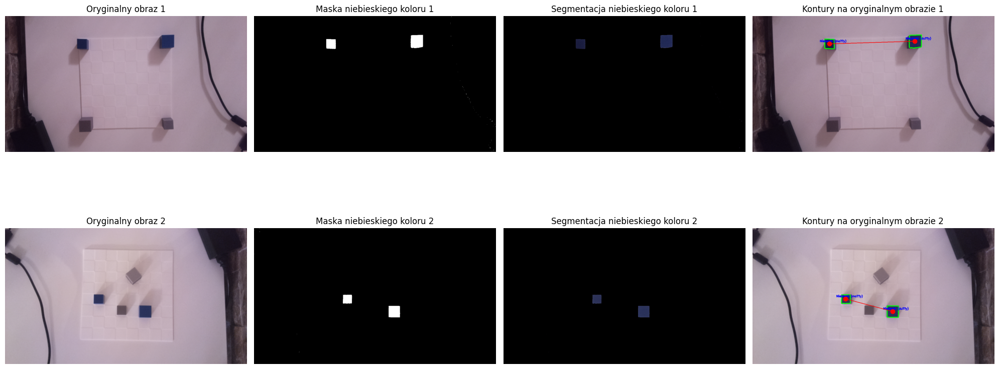

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def process_image(image_path):
    # Wczytaj obraz
    image = cv2.imread(image_path)

    # Sprawdź czy obraz został wczytany poprawnie
    if image is None:
        print(f"Nie udało się wczytać obrazu {image_path}")
        return None, None, None, None

    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(image, image, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Rysowanie konturów na oryginalnym obrazie
    contoured_image = image.copy()
    cv2.drawContours(contoured_image, filtered_contours, -1, (0, 255, 0), 3)  # Rysowanie konturów kolorem zielonym

    # Obliczanie środków elementów, ich powierzchni i dodawanie etykiet
    centroids = []
    areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        area = cv2.contourArea(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids.append((cX, cY))
            areas.append(area)
        else:
            centroids.append((0, 0))
            areas.append(0)

    if len(areas) == 2:
        # Dodanie etykiety "duży" lub "mały" w zależności od powierzchni konturu
        if areas[0] > areas[1]:
            labels = ["duży", "mały"]
        else:
            labels = ["mały", "duży"]

        for (cX, cY), label in zip(centroids, labels):
            cv2.putText(contoured_image, f'Niebieski ({label})', (cX - 50, cY - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

        min_area = min(areas)
        max_area = max(areas)
        scale_factor = np.sqrt(max_area / min_area)  # Stosunek skalowania

        # Odległość między środkami elementów w pikselach
        distance_pixels = np.linalg.norm(np.array(centroids[0]) - np.array(centroids[1]))

        # Skalowanie odległości na podstawie rzeczywistych wymiarów
        distance_real = distance_pixels / scale_factor

        # Rysowanie linii między środkami elementów
        cv2.line(contoured_image, centroids[0], centroids[1], (0, 0, 255), 2)  # Czerwona linia

        return image, mask, result, contoured_image, centroids, distance_pixels, distance_real, areas

    else:
        print(f"Nie wykryto dokładnie dwóch elementów na obrazie {image_path}")
        return None, None, None, None, None, None, None, None

# Ścieżki do obrazów
image_path1 = '/content/images/images/train/zdjecie10.jpg'
image_path2 = '/content/images/images/train/zdjecie11.jpg'

# Przetwarzanie obrazów
results1 = process_image(image_path1)
results2 = process_image(image_path2)

# Wyświetlanie wyników
if results1[0] is not None and results2[0] is not None:
    fig, axes = plt.subplots(2, 4, figsize=(20, 10))

    for i, (image, mask, result, contoured_image, centroids, distance_pixels, distance_real, areas) in enumerate([results1, results2]):
        if image is not None:
            axes[i, 0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            axes[i, 0].set_title(f'Oryginalny obraz {i+1}')
            axes[i, 0].axis('off')

            axes[i, 1].imshow(mask, cmap='gray')
            axes[i, 1].set_title(f'Maska niebieskiego koloru {i+1}')
            axes[i, 1].axis('off')

            axes[i, 2].imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
            axes[i, 2].set_title(f'Segmentacja niebieskiego koloru {i+1}')
            axes[i, 2].axis('off')

            axes[i, 3].imshow(cv2.cvtColor(contoured_image, cv2.COLOR_BGR2RGB))
            axes[i, 3].set_title(f'Kontury na oryginalnym obrazie {i+1}')
            for centroid in centroids:
                axes[i, 3].scatter(*centroid, color='red')
            axes[i, 3].axis('off')

            print(f"Obraz {i+1}:")
            print(f"Odległość między środkami elementów w pikselach: {distance_pixels:.2f}")
            print(f"Szacowana odległość rzeczywista między elementami: {distance_real:.2f}")
            print(f"Powierzchnie konturów: {areas[0]:.2f} (mniejszy) i {areas[1]:.2f} (większy)")

    plt.tight_layout()
    plt.show()
else:
    print("Przetwarzanie obrazów zakończone niepowodzeniem.")


## **4.Odczytywanie pozycji na dwóch zdjęciach plus poprawa wyświetlania etykiet**

Obraz 1:
Odległość między środkami elementów w pikselach: 454.22
Szacowana odległość rzeczywista między elementami: 347.46
Powierzchnie konturów: 2475.00 (smaller) i 4229.50 (bigger)
Obraz 2:
Odległość między środkami elementów w pikselach: 256.63
Szacowana odległość rzeczywista między elementami: 198.26
Powierzchnie konturów: 2108.00 (smaller) i 3532.00 (bigger)


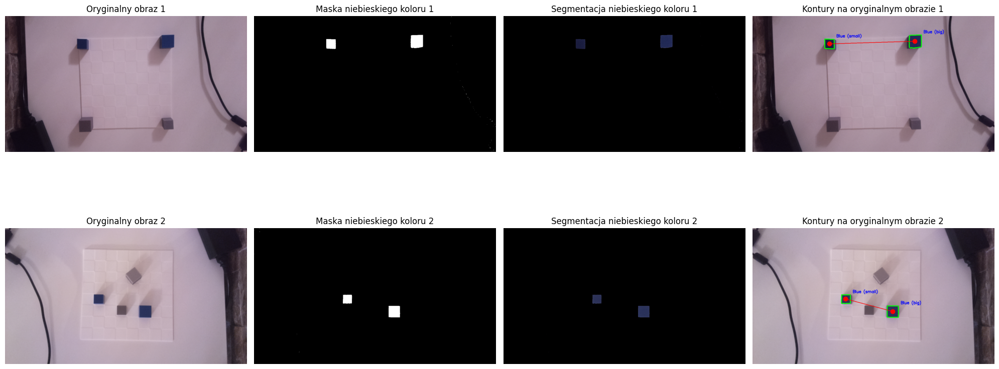

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def process_image(image_path):
    # Wczytaj obraz
    image = cv2.imread(image_path)

    # Sprawdź czy obraz został wczytany poprawnie
    if image is None:
        print(f"Nie udało się wczytać obrazu {image_path}")
        return None, None, None, None, None, None, None, None

    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(image, image, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Obliczanie środków elementów, ich powierzchni i dodawanie etykiet
    contoured_image = image.copy()
    centroids_areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        area = cv2.contourArea(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids_areas.append(((cX, cY), area, cnt))
        else:
            centroids_areas.append(((0, 0), area, cnt))

    if len(centroids_areas) == 2:
        # Sortowanie konturów według powierzchni
        centroids_areas.sort(key=lambda x: x[1])

        # Przypisywanie etykiet "small" i "big"
        labels = ["small", "big"]
        centroids = [ca[0] for ca in centroids_areas]
        areas = [ca[1] for ca in centroids_areas]
        contours = [ca[2] for ca in centroids_areas]

        for (cX, cY), area, cnt, label in zip(centroids, areas, contours, labels):
            # Znajdowanie prawego górnego rogu konturu
            x, y, w, h = cv2.boundingRect(cnt)
            text_position = (x + w + 10, y - 10)  # Po prawej stronie od prawego górnego rogu

            # Rysowanie etykiety
            cv2.putText(contoured_image, f'Blue ({label})', text_position, cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 0, 0), 2)

        cv2.drawContours(contoured_image, contours, -1, (0, 255, 0), 3)

        min_area = min(areas)
        max_area = max(areas)
        scale_factor = np.sqrt(max_area / min_area)  # Stosunek skalowania

        # Odległość między środkami elementów w pikselach
        distance_pixels = np.linalg.norm(np.array(centroids[0]) - np.array(centroids[1]))

        # Skalowanie odległości na podstawie rzeczywistych wymiarów
        distance_real = distance_pixels / scale_factor

        # Rysowanie linii między środkami elementów
        cv2.line(contoured_image, centroids[0], centroids[1], (0, 0, 255), 2)  # Czerwona linia

        return image, mask, result, contoured_image, centroids, distance_pixels, distance_real, areas

    else:
        print(f"Nie wykryto dokładnie dwóch elementów na obrazie {image_path}")
        return None, None, None, None, None, None, None, None

# Ścieżki do obrazów
image_path1 = '/content/images/images/train/zdjecie10.jpg'
image_path2 = '/content/images/images/train/zdjecie11.jpg'

# Przetwarzanie obrazów
results1 = process_image(image_path1)
results2 = process_image(image_path2)

# Wyświetlanie wyników
if results1[0] is not None and results2[0] is not None:
    fig, axes = plt.subplots(2, 4, figsize=(20, 10))

    for i, (image, mask, result, contoured_image, centroids, distance_pixels, distance_real, areas) in enumerate([results1, results2]):
        if image is not None:
            axes[i, 0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            axes[i, 0].set_title(f'Oryginalny obraz {i+1}')
            axes[i, 0].axis('off')

            axes[i, 1].imshow(mask, cmap='gray')
            axes[i, 1].set_title(f'Maska niebieskiego koloru {i+1}')
            axes[i, 1].axis('off')

            axes[i, 2].imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
            axes[i, 2].set_title(f'Segmentacja niebieskiego koloru {i+1}')
            axes[i, 2].axis('off')

            axes[i, 3].imshow(cv2.cvtColor(contoured_image, cv2.COLOR_BGR2RGB))
            axes[i, 3].set_title(f'Kontury na oryginalnym obrazie {i+1}')
            for centroid in centroids:
                axes[i, 3].scatter(*centroid, color='red')
            axes[i, 3].axis('off')

            print(f"Obraz {i+1}:")
            print(f"Odległość między środkami elementów w pikselach: {distance_pixels:.2f}")
            print(f"Szacowana odległość rzeczywista między elementami: {distance_real:.2f}")
            print(f"Powierzchnie konturów: {areas[0]:.2f} (smaller) i {areas[1]:.2f} (bigger)")

    plt.tight_layout()
    plt.show()
else:
    print("Przetwarzanie obrazów zakończone niepowodzeniem.")


## **5.Rysowanie wektora przesunięcia elementu pomiędzy pozycjami z dwóch zdjęć**

Obraz 1:
Odległość między środkami elementów w pikselach: 454.22
Szacowana odległość rzeczywista między elementami: 347.46
Powierzchnie konturów: 2475.00 (smaller) i 4229.50 (bigger)
Obraz 2:
Odległość między środkami elementów w pikselach: 256.63
Szacowana odległość rzeczywista między elementami: 198.26
Powierzchnie konturów: 2108.00 (smaller) i 3532.00 (bigger)


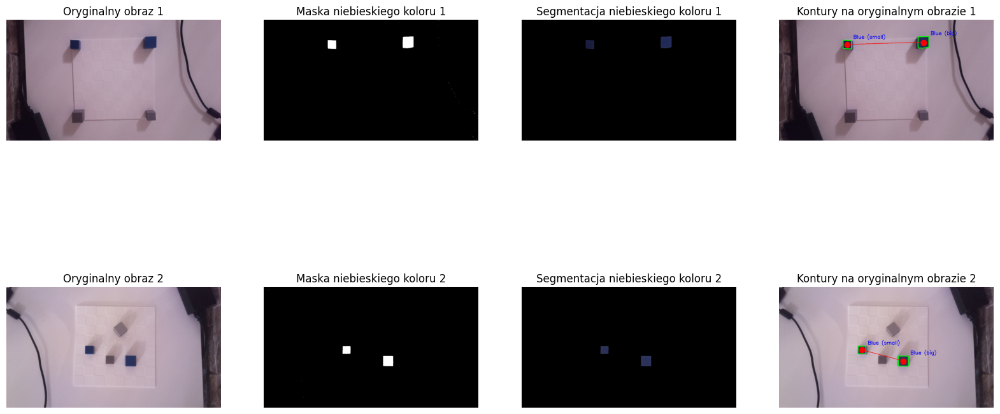

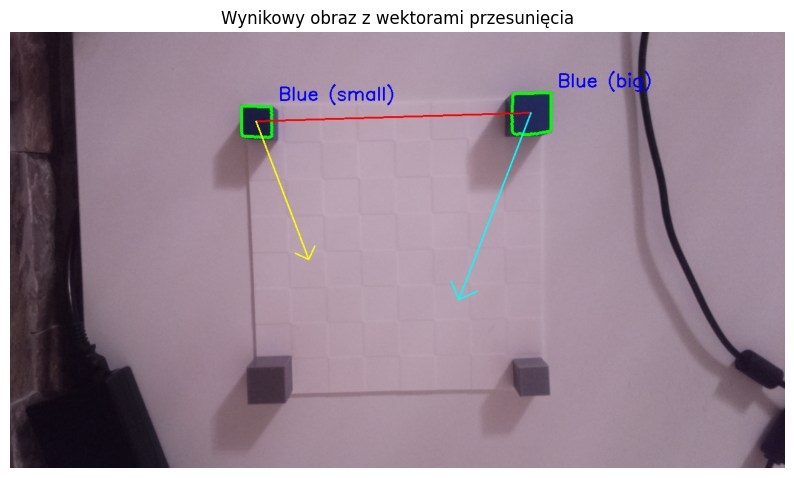

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def process_image(image_path):
    # Wczytaj obraz
    image = cv2.imread(image_path)

    # Sprawdź czy obraz został wczytany poprawnie
    if image is None:
        print(f"Nie udało się wczytać obrazu {image_path}")
        return None, None, None, None, None, None, None, None

    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(image, image, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Obliczanie środków elementów, ich powierzchni i dodawanie etykiet
    contoured_image = image.copy()
    centroids_areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        area = cv2.contourArea(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids_areas.append(((cX, cY), area, cnt))
        else:
            centroids_areas.append(((0, 0), area, cnt))

    if len(centroids_areas) == 2:
        # Sortowanie konturów według powierzchni
        centroids_areas.sort(key=lambda x: x[1])

        # Przypisywanie etykiet "small" i "big"
        labels = ["small", "big"]
        centroids = [ca[0] for ca in centroids_areas]
        areas = [ca[1] for ca in centroids_areas]
        contours = [ca[2] for ca in centroids_areas]

        for (cX, cY), area, cnt, label in zip(centroids, areas, contours, labels):
            # Znajdowanie prawego górnego rogu konturu
            x, y, w, h = cv2.boundingRect(cnt)
            text_position = (x + w + 10, y - 10)  # Po prawej stronie od prawego górnego rogu

            # Rysowanie etykiety
            cv2.putText(contoured_image, f'Blue ({label})', text_position, cv2.FONT_HERSHEY_SIMPLEX, 1.0, (255, 0, 0), 2)

        cv2.drawContours(contoured_image, contours, -1, (0, 255, 0), 3)

        min_area = min(areas)
        max_area = max(areas)
        scale_factor = np.sqrt(max_area / min_area)  # Stosunek skalowania

        # Odległość między środkami elementów w pikselach
        distance_pixels = np.linalg.norm(np.array(centroids[0]) - np.array(centroids[1]))

        # Skalowanie odległości na podstawie rzeczywistych wymiarów
        distance_real = distance_pixels / scale_factor

        # Rysowanie linii między środkami elementów
        cv2.line(contoured_image, centroids[0], centroids[1], (0, 0, 255), 2)  # Czerwona linia

        return image, mask, result, contoured_image, centroids, distance_pixels, distance_real, areas, labels

    else:
        print(f"Nie wykryto dokładnie dwóch elementów na obrazie {image_path}")
        return None, None, None, None, None, None, None, None, None

# Ścieżki do obrazów
image_path1 = '/content/images/images/train/zdjecie10.jpg'
image_path2 = '/content/images/images/train/zdjecie11.jpg'

# Przetwarzanie obrazów
results1 = process_image(image_path1)
results2 = process_image(image_path2)

# Wyświetlanie wyników
if results1[0] is not None and results2[0] is not None:
    fig, axes = plt.subplots(2, 4, figsize=(20, 10))

    for i, (image, mask, result, contoured_image, centroids, distance_pixels, distance_real, areas, labels) in enumerate([results1, results2]):
        if image is not None:
            axes[i, 0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            axes[i, 0].set_title(f'Oryginalny obraz {i+1}')
            axes[i, 0].axis('off')

            axes[i, 1].imshow(mask, cmap='gray')
            axes[i, 1].set_title(f'Maska niebieskiego koloru {i+1}')
            axes[i, 1].axis('off')

            axes[i, 2].imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
            axes[i, 2].set_title(f'Segmentacja niebieskiego koloru {i+1}')
            axes[i, 2].axis('off')

            axes[i, 3].imshow(cv2.cvtColor(contoured_image, cv2.COLOR_BGR2RGB))
            axes[i, 3].set_title(f'Kontury na oryginalnym obrazie {i+1}')
            for centroid in centroids:
                axes[i, 3].scatter(*centroid, color='red')
            axes[i, 3].axis('off')

            print(f"Obraz {i+1}:")
            print(f"Odległość między środkami elementów w pikselach: {distance_pixels:.2f}")
            print(f"Szacowana odległość rzeczywista między elementami: {distance_real:.2f}")
            print(f"Powierzchnie konturów: {areas[0]:.2f} (smaller) i {areas[1]:.2f} (bigger)")

    # Tworzenie obrazu wynikowego z zaznaczonymi wektorami przesunięcia
    result_image = results1[3].copy()  # Kopia konturowanego obrazu z pierwszego zdjęcia

    # Wektor przesunięcia dla "small"
    small_index1 = results1[8].index("small")
    small_index2 = results2[8].index("small")
    cv2.arrowedLine(result_image, results1[4][small_index1], results2[4][small_index2], (0, 255, 255), 2)  # Żółty wektor

    # Wektor przesunięcia dla "big"
    big_index1 = results1[8].index("big")
    big_index2 = results2[8].index("big")
    cv2.arrowedLine(result_image, results1[4][big_index1], results2[4][big_index2], (255, 255, 0), 2)  # Cyan wektor

    # Wyświetlanie obrazu wynikowego
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
    plt.title('Wynikowy obraz z wektorami przesunięcia')
    plt.axis('off')
    plt.show()

else:
    print("Przetwarzanie obrazów zakończone niepowodzeniem.")


## **6.Rysowanie wektora przesunięcia elementów - poprawki**

Obraz 1:
Odległość między środkami elementów w pikselach: 433.00
Szacowana odległość rzeczywista między elementami: 332.56
Powierzchnie konturów: 2077.50 (smaller) i 3522.00 (bigger)
Obraz 2:
Odległość między środkami elementów w pikselach: 256.63
Szacowana odległość rzeczywista między elementami: 198.26
Powierzchnie konturów: 2108.00 (smaller) i 3532.00 (bigger)


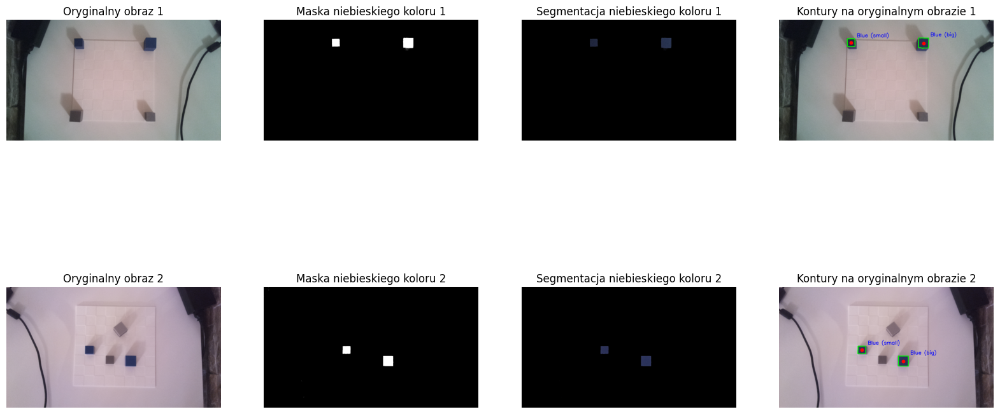

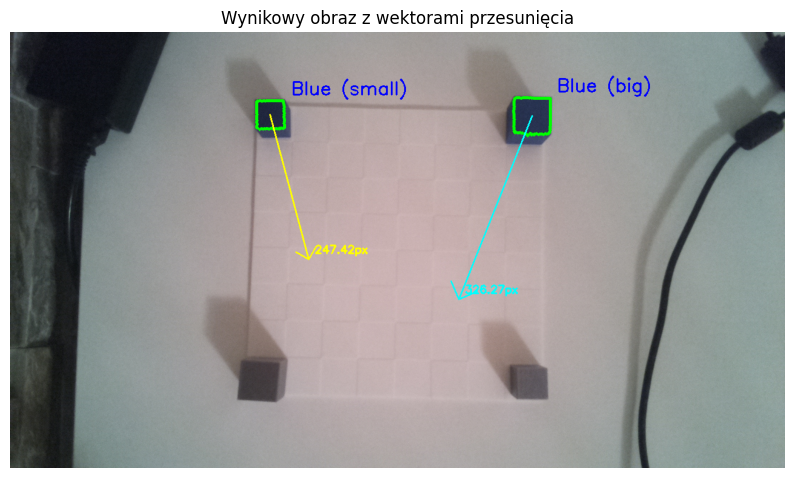

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def process_image(image_path):
    # Wczytaj obraz
    image = cv2.imread(image_path)

    # Sprawdź czy obraz został wczytany poprawnie
    if image is None:
        print(f"Nie udało się wczytać obrazu {image_path}")
        return None, None, None, None, None, None, None, None

    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(image, image, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Obliczanie środków elementów, ich powierzchni i dodawanie etykiet
    contoured_image = image.copy()
    centroids_areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        area = cv2.contourArea(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids_areas.append(((cX, cY), area, cnt))
        else:
            centroids_areas.append(((0, 0), area, cnt))

    if len(centroids_areas) == 2:
        # Sortowanie konturów według powierzchni
        centroids_areas.sort(key=lambda x: x[1])

        # Przypisywanie etykiet "small" i "big"
        labels = ["small", "big"]
        centroids = [ca[0] for ca in centroids_areas]
        areas = [ca[1] for ca in centroids_areas]
        contours = [ca[2] for ca in centroids_areas]

        for (cX, cY), area, cnt, label in zip(centroids, areas, contours, labels):
            # Znajdowanie prawego górnego rogu konturu
            x, y, w, h = cv2.boundingRect(cnt)
            text_position = (x + w + 10, y - 10)  # Po prawej stronie od prawego górnego rogu

            # Rysowanie etykiety
            cv2.putText(contoured_image, f'Blue ({label})', text_position, cv2.FONT_HERSHEY_SIMPLEX, 1.0, (255, 0, 0), 2)

        cv2.drawContours(contoured_image, contours, -1, (0, 255, 0), 3)

        min_area = min(areas)
        max_area = max(areas)
        scale_factor = np.sqrt(max_area / min_area)  # Stosunek skalowania

        # Odległość między środkami elementów w pikselach
        distance_pixels = np.linalg.norm(np.array(centroids[0]) - np.array(centroids[1]))

        # Skalowanie odległości na podstawie rzeczywistych wymiarów
        distance_real = distance_pixels / scale_factor

        return image, mask, result, contoured_image, centroids, distance_pixels, distance_real, areas, labels

    else:
        print(f"Nie wykryto dokładnie dwóch elementów na obrazie {image_path}")
        return None, None, None, None, None, None, None, None, None

# Ścieżki do obrazów
image_path1 = '/content/images/images/train/zdjecie1.jpg'
image_path2 = '/content/images/images/train/zdjecie11.jpg'

# Przetwarzanie obrazów
results1 = process_image(image_path1)
results2 = process_image(image_path2)

# Wyświetlanie wyników
if results1[0] is not None and results2[0] is not None:
    fig, axes = plt.subplots(2, 4, figsize=(20, 10))

    for i, (image, mask, result, contoured_image, centroids, distance_pixels, distance_real, areas, labels) in enumerate([results1, results2]):
        if image is not None:
            axes[i, 0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            axes[i, 0].set_title(f'Oryginalny obraz {i+1}')
            axes[i, 0].axis('off')

            axes[i, 1].imshow(mask, cmap='gray')
            axes[i, 1].set_title(f'Maska niebieskiego koloru {i+1}')
            axes[i, 1].axis('off')

            axes[i, 2].imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
            axes[i, 2].set_title(f'Segmentacja niebieskiego koloru {i+1}')
            axes[i, 2].axis('off')

            axes[i, 3].imshow(cv2.cvtColor(contoured_image, cv2.COLOR_BGR2RGB))
            axes[i, 3].set_title(f'Kontury na oryginalnym obrazie {i+1}')
            for centroid in centroids:
                axes[i, 3].scatter(*centroid, color='red', s=10)  # Mniejsza kropka
            axes[i, 3].axis('off')

            print(f"Obraz {i+1}:")
            print(f"Odległość między środkami elementów w pikselach: {distance_pixels:.2f}")
            print(f"Szacowana odległość rzeczywista między elementami: {distance_real:.2f}")
            print(f"Powierzchnie konturów: {areas[0]:.2f} (smaller) i {areas[1]:.2f} (bigger)")

    # Tworzenie obrazu wynikowego z zaznaczonymi wektorami przesunięcia
    result_image = results1[3].copy()  # Kopia konturowanego obrazu z pierwszego zdjęcia

    # Wektor przesunięcia dla "small"
    small_index1 = results1[8].index("small")
    small_index2 = results2[8].index("small")
    cv2.arrowedLine(result_image, results1[4][small_index1], results2[4][small_index2], (0, 255, 255), 2)  # Żółty wektor
    # Dodawanie tekstu na końcu wektora
    small_displacement = np.linalg.norm(np.array(results1[4][small_index1]) - np.array(results2[4][small_index2]))
    small_text_position = (results2[4][small_index2][0] + 10, results2[4][small_index2][1] - 10)
    cv2.putText(result_image, f'{small_displacement:.2f}px', small_text_position, cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 255), 2)

    # Wektor przesunięcia dla "big"
    big_index1 = results1[8].index("big")
    big_index2 = results2[8].index("big")
    cv2.arrowedLine(result_image, results1[4][big_index1], results2[4][big_index2], (255, 255, 0), 2)  # Cyan wektor
    # Dodawanie tekstu na końcu wektora
    big_displacement = np.linalg.norm(np.array(results1[4][big_index1]) - np.array(results2[4][big_index2]))
    big_text_position = (results2[4][big_index2][0] + 10, results2[4][big_index2][1] - 10)
    cv2.putText(result_image, f'{big_displacement:.2f}px', big_text_position, cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 0), 2)

    # Wyświetlanie obrazu wynikowego
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(result_image, cv2.COLOR_BGR2RGB))
    plt.title('Wynikowy obraz z wektorami przesunięcia')
    plt.axis('off')
    plt.show()

else:
    print("Przetwarzanie obrazów zakończone niepowodzeniem.")


# **01.07.2024 - Dodawanie sprawdzania na żywo**

## **1.Zaznaczanie położenia + przesunięcia**

In [ ]:
import cv2
import numpy as np
import time

# Ustawienie kamery
cap = cv2.VideoCapture(0)

if not cap.isOpened():
    print("Nie udało się otworzyć kamery")
    exit()

# Inicjalizacja poprzednich pozycji centroidów, historii punktów i czasu stabilności
previous_centroids = []
history_points = []
stable_since = []  # Lista przechowująca czasy stabilności dla każdego elementu
stability_threshold = 1  # Czas w sekundach, przez który pozycja musi być stabilna

# Inicjalizacja zmiennej czasu dla wyświetlania współrzędnych
last_time = time.time()

while True:
    # Wczytaj obraz z kamery
    ret, frame = cap.read()

    # Sprawdź, czy obraz został wczytany poprawnie
    if not ret:
        print("Nie udało się wczytać klatki z kamery")
        break

    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(frame, frame, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Rysowanie konturów na oryginalnym obrazie
    contoured_image = frame.copy()
    cv2.drawContours(contoured_image, filtered_contours, -1, (0, 255, 0), 3)  # Rysowanie konturów kolorem zielonym

    # Obliczanie środków elementów i ich powierzchni
    centroids = []
    areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids.append((cX, cY))
            areas.append(cv2.contourArea(cnt))
            # Dodanie etykiety z kolorem
            cv2.putText(contoured_image, 'Niebieski', (cX - 50, cY - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
        else:
            centroids.append((0, 0))
            areas.append(0)

    # Zakładamy, że mniejszy element ma rzeczywiste wymiary 1x1 a większy 2x2
    if len(areas) == 2:
        min_area = min(areas)
        max_area = max(areas)
        scale_factor = np.sqrt(max_area / min_area)  # Stosunek skalowania

        # Odległość między środkami elementów w pikselach
        distance_pixels = np.linalg.norm(np.array(centroids[0]) - np.array(centroids[1]))

        # Skalowanie odległości na podstawie rzeczywistych wymiarów
        distance_real = distance_pixels / scale_factor

        # Wyświetlanie wyników
        print(f"Odległość między środkami elementów w pikselach: {distance_pixels:.2f}")
        print(f"Szacowana odległość rzeczywista między elementami: {distance_real:.2f}")

    # Sprawdzenie stabilności i zapisywanie punktów, jeśli pozycja jest stabilna przez 1 sekundę
    current_time = time.time()
    if previous_centroids:
        for i, (prev, curr) in enumerate(zip(previous_centroids, centroids)):
            if prev != curr:
                # Zaktualizuj czas ostatniej zmiany pozycji
                if i < len(stable_since):
                    stable_since[i] = current_time
                else:
                    stable_since.append(current_time)
            else:
                # Sprawdź, czy pozycja jest stabilna przez wystarczająco długi czas
                if i < len(stable_since) and current_time - stable_since[i] >= stability_threshold:
                    # Dodaj punkt do historii, jeśli jest stabilny przez 1 sekundę
                    if len(history_points) == 0 or history_points[-1][0] != curr:
                        history_points.append((curr, len(history_points) + 1))
                    stable_since[i] = current_time  # Zresetuj czas stabilności

    # Rysowanie linii przemieszczenia, jeśli pozycje się zmieniły
    if previous_centroids:
        for prev, curr in zip(previous_centroids, centroids):
            if prev != curr:
                cv2.line(contoured_image, prev, curr, (0, 0, 255), 2)  # Rysowanie czerwonej linii

    # Rysowanie wszystkich punktów z historii
    for point, index in history_points:
        cv2.circle(contoured_image, point, 5, (0, 0, 255), -1)  # Rysowanie kropki
        cv2.putText(contoured_image, str(index), (point[0] + 10, point[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

    # Zaktualizuj poprzednie centroids
    previous_centroids = centroids.copy()

    # Wyświetlanie aktualnych koordynatów co 5 sekund
    if current_time - last_time >= 5:
        last_time = current_time
        print("Aktualne koordynaty:")
        for i, (cX, cY) in enumerate(centroids):
            print(f"Element {i+1}: ({cX}, {cY})")

    # Wyświetlanie obrazu z naniesionymi konturami, liniami przemieszczenia i punktami
    cv2.imshow('Kontury na oryginalnym obrazie', contoured_image)

    # Zakończenie działania po naciśnięciu klawisza 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Zwolnienie zasobów
cap.release()
cv2.destroyAllWindows()


## **2.Aruco markers**

In [ ]:
import numpy as np
import time
import cv2
from imutils.video import WebcamVideoStream
import imutils


ARUCO_DICT = {
	"DICT_4X4_50": cv2.aruco.DICT_4X4_50,
	"DICT_4X4_100": cv2.aruco.DICT_4X4_100,
	"DICT_4X4_250": cv2.aruco.DICT_4X4_250,
	"DICT_4X4_1000": cv2.aruco.DICT_4X4_1000,
	"DICT_5X5_50": cv2.aruco.DICT_5X5_50,
	"DICT_5X5_100": cv2.aruco.DICT_5X5_100,
	"DICT_5X5_250": cv2.aruco.DICT_5X5_250,
	"DICT_5X5_1000": cv2.aruco.DICT_5X5_1000,
	"DICT_6X6_50": cv2.aruco.DICT_6X6_50,
	"DICT_6X6_100": cv2.aruco.DICT_6X6_100,
	"DICT_6X6_250": cv2.aruco.DICT_6X6_250,
	"DICT_6X6_1000": cv2.aruco.DICT_6X6_1000,
	"DICT_7X7_50": cv2.aruco.DICT_7X7_50,
	"DICT_7X7_100": cv2.aruco.DICT_7X7_100,
	"DICT_7X7_250": cv2.aruco.DICT_7X7_250,
	"DICT_7X7_1000": cv2.aruco.DICT_7X7_1000,
	"DICT_ARUCO_ORIGINAL": cv2.aruco.DICT_ARUCO_ORIGINAL,
}

aruco_type = [	"DICT_4X4_50", "DICT_4X4_100", "DICT_4X4_250",
	"DICT_4X4_1000","DICT_5X5_50","DICT_5X5_100","DICT_5X5_250",
	"DICT_5X5_1000","DICT_6X6_50","DICT_6X6_100","DICT_6X6_250",
	"DICT_6X6_1000","DICT_7X7_50","DICT_7X7_100",
	"DICT_7X7_250","DICT_7X7_1000","DICT_ARUCO_ORIGINAL"]


def aruco_display(corners, ids, rejected, image):
	if len(corners) > 0:

		ids = ids.flatten()

		for (markerCorner, markerID) in zip(corners, ids):

			corners = markerCorner.reshape((4, 2))
			(topLeft, topRight, bottomRight, bottomLeft) = corners

			topRight = (int(topRight[0]), int(topRight[1]))
			bottomRight = (int(bottomRight[0]), int(bottomRight[1]))
			bottomLeft = (int(bottomLeft[0]), int(bottomLeft[1]))
			topLeft = (int(topLeft[0]), int(topLeft[1]))

			cv2.line(image, topLeft, topRight, (0, 255, 0), 2)
			cv2.line(image, topRight, bottomRight, (0, 255, 0), 2)
			cv2.line(image, bottomRight, bottomLeft, (0, 255, 0), 2)
			cv2.line(image, bottomLeft, topLeft, (0, 255, 0), 2)

			cX = int((topLeft[0] + bottomRight[0]) / 2.0)
			cY = int((topLeft[1] + bottomRight[1]) / 2.0)
			cv2.circle(image, (cX, cY), 4, (0, 0, 255), -1)

			cv2.putText(image, str(markerID),(topLeft[0], topLeft[1] - 10), cv2.FONT_HERSHEY_SIMPLEX,
				0.5, (0, 255, 0), 2)
			print("[Inference] ArUco marker ID: {}".format(markerID))

			print(cX)
			print(cY)

	return image

def pose_estimation(frame, arucoDict, matrix_coeff, distortion_coeff):

	if len(corners) > 0:

		rvec, tvec, _ = cv2.aruco.estimatePoseSingleMarkers(corners[i], 0.02, matrix_coeff, distortion_coeff)

		cv2.aruco.drawDetectedMarkers(frame, corners)

		cv2.aruco.drawAxis(frame, matrix_coeff, distortion_coeff, rvec, tvec, 0.01)

		return frame


intrinsic_camera = np.array([[504.27569085, 0., 321.14686652],
                [0., 504.25709983, 250.90746025],
                [0., 0., 1.]])

distortion = np.array([[0.18183136, -0.29152863, 0.00247659, 0.00436188, -0.09306431]])

#img = cv2.imread('/home/pi/Desktop/aruco/arr',1)

cap = cv2.VideoCapture(0)

cap.set(cv2.CAP_PROP_FRAME_WIDTH, 1280)
cap.set(cv2.CAP_PROP_FRAME_HEIGHT, 720)

while cap.isOpened():

	ret, img = cap.read()

	h, w, _ = img.shape
	width = 1000
	height = int(width*(h/w))

	img = cv2.resize(img, (width, height), interpolation = cv2.INTER_CUBIC)

	for i in aruco_type:

		arucoDict = cv2.aruco.getPredefinedDictionary(ARUCO_DICT[i])

		arucoParams = cv2.aruco.DetectorParameters()

		detector = cv2.aruco.ArucoDetector(arucoDict,arucoParams)

		corners, ids, rejected = detector.detectMarkers(img)

		detected_markers = aruco_display(corners, ids, rejected, img)

	cv2.imshow("Image", detected_markers)

	key = cv2.waitKey(1) & 0xFF

	if key == ord("q"):
		break

cv2.destroyAllWindows()
cap.release()


# **02.07.2024 - Kalibracja kamery plus aruco markery**

## **1.Wykrywanie elementów plus aruco markers**

In [ ]:
import cv2
import numpy as np
import time
from imutils.video import WebcamVideoStream
import imutils

# Ustawienie kamery
cap = cv2.VideoCapture(0)

if not cap.isOpened():
    print("Nie udało się otworzyć kamery")
    exit()

# Inicjalizacja poprzednich pozycji centroidów, historii punktów i czasu stabilności
previous_centroids = []
history_points = []
stable_since = []  # Lista przechowująca czasy stabilności dla każdego elementu
stability_threshold = 1  # Czas w sekundach, przez który pozycja musi być stabilna

# Inicjalizacja zmiennej czasu dla wyświetlania współrzędnych
last_time = time.time()

# ArUco setup
ARUCO_DICT = {
    "DICT_4X4_50": cv2.aruco.DICT_4X4_50,
    "DICT_4X4_100": cv2.aruco.DICT_4X4_100,
    "DICT_4X4_250": cv2.aruco.DICT_4X4_250,
    "DICT_4X4_1000": cv2.aruco.DICT_4X4_1000,
    "DICT_5X5_50": cv2.aruco.DICT_5X5_50,
    "DICT_5X5_100": cv2.aruco.DICT_5X5_100,
    "DICT_5X5_250": cv2.aruco.DICT_5X5_250,
    "DICT_5X5_1000": cv2.aruco.DICT_5X5_1000,
    "DICT_6X6_50": cv2.aruco.DICT_6X6_50,
    "DICT_6X6_100": cv2.aruco.DICT_6X6_100,
    "DICT_6X6_250": cv2.aruco.DICT_6X6_250,
    "DICT_6X6_1000": cv2.aruco.DICT_6X6_1000,
    "DICT_7X7_50": cv2.aruco.DICT_7X7_50,
    "DICT_7X7_100": cv2.aruco.DICT_7X7_100,
    "DICT_7X7_250": cv2.aruco.DICT_7X7_250,
    "DICT_7X7_1000": cv2.aruco.DICT_7X7_1000,
    "DICT_ARUCO_ORIGINAL": cv2.aruco.DICT_ARUCO_ORIGINAL,
}

aruco_type = [
    "DICT_4X4_50", "DICT_4X4_100", "DICT_4X4_250",
    "DICT_4X4_1000", "DICT_5X5_50", "DICT_5X5_100", "DICT_5X5_250",
    "DICT_5X5_1000", "DICT_6X6_50", "DICT_6X6_100", "DICT_6X6_250",
    "DICT_6X6_1000", "DICT_7X7_50", "DICT_7X7_100",
    "DICT_7X7_250", "DICT_7X7_1000", "DICT_ARUCO_ORIGINAL"
]

def aruco_display(corners, ids, rejected, image):
    if len(corners) > 0:
        ids = ids.flatten()
        for (markerCorner, markerID) in zip(corners, ids):
            corners = markerCorner.reshape((4, 2))
            (topLeft, topRight, bottomRight, bottomLeft) = corners

            topRight = (int(topRight[0]), int(topRight[1]))
            bottomRight = (int(bottomRight[0]), int(bottomRight[1]))
            bottomLeft = (int(bottomLeft[0]), int(bottomLeft[1]))
            topLeft = (int(topLeft[0]), int(topLeft[1]))

            cv2.line(image, topLeft, topRight, (0, 255, 0), 2)
            cv2.line(image, topRight, bottomRight, (0, 255, 0), 2)
            cv2.line(image, bottomRight, bottomLeft, (0, 255, 0), 2)
            cv2.line(image, bottomLeft, topLeft, (0, 255, 0), 2)

            cX = int((topLeft[0] + bottomRight[0]) / 2.0)
            cY = int((topLeft[1] + bottomRight[1]) / 2.0)
            cv2.circle(image, (cX, cY), 4, (0, 0, 255), -1)

            cv2.putText(image, str(markerID), (topLeft[0], topLeft[1] - 10), cv2.FONT_HERSHEY_SIMPLEX,
                        0.5, (0, 255, 0), 2)
            print("[Inference] ArUco marker ID: {}".format(markerID))

            print(cX)
            print(cY)

    return image

while True:
    # Wczytaj obraz z kamery
    ret, frame = cap.read()

    # Sprawdź, czy obraz został wczytany poprawnie
    if not ret:
        print("Nie udało się wczytać klatki z kamery")
        break

    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(frame, frame, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Rysowanie konturów na oryginalnym obrazie
    contoured_image = frame.copy()
    cv2.drawContours(contoured_image, filtered_contours, -1, (0, 255, 0), 3)  # Rysowanie konturów kolorem zielonym

    # Obliczanie środków elementów i ich powierzchni
    centroids = []
    areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids.append((cX, cY))
            areas.append(cv2.contourArea(cnt))
            # Dodanie etykiety z kolorem
            cv2.putText(contoured_image, 'Niebieski', (cX - 50, cY - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
        else:
            centroids.append((0, 0))
            areas.append(0)

    # Zakładamy, że mniejszy element ma rzeczywiste wymiary 1x1 a większy 2x2
    if len(areas) == 2:
        min_area = min(areas)
        max_area = max(areas)
        scale_factor = np.sqrt(max_area / min_area)  # Stosunek skalowania

        # Odległość między środkami elementów w pikselach
        distance_pixels = np.linalg.norm(np.array(centroids[0]) - np.array(centroids[1]))

        # Skalowanie odległości na podstawie rzeczywistych wymiarów
        distance_real = distance_pixels / scale_factor

        # Wyświetlanie wyników
        print(f"Odległość między środkami elementów w pikselach: {distance_pixels:.2f}")
        print(f"Szacowana odległość rzeczywista między elementami: {distance_real:.2f}")

    # Sprawdzenie stabilności i zapisywanie punktów, jeśli pozycja jest stabilna przez 1 sekundę
    current_time = time.time()
    if previous_centroids:
        for i, (prev, curr) in enumerate(zip(previous_centroids, centroids)):
            if prev != curr:
                # Zaktualizuj czas ostatniej zmiany pozycji
                if i < len(stable_since):
                    stable_since[i] = current_time
                else:
                    stable_since.append(current_time)
            else:
                # Sprawdź, czy pozycja jest stabilna przez wystarczająco długi czas
                if i < len(stable_since) and current_time - stable_since[i] >= stability_threshold:
                    # Dodaj punkt do historii, jeśli jest stabilny przez 1 sekundę
                    if len(history_points) == 0 or history_points[-1][0] != curr:
                        history_points.append((curr, len(history_points) + 1))
                    stable_since[i] = current_time  # Zresetuj czas stabilności

    # Rysowanie linii przemieszczenia, jeśli pozycje się zmieniły
    if previous_centroids:
        for prev, curr in zip(previous_centroids, centroids):
            if prev != curr:
                cv2.line(contoured_image, prev, curr, (0, 0, 255), 2)  # Rysowanie czerwonej linii

    # Rysowanie wszystkich punktów z historii
    for point, index in history_points:
        cv2.circle(contoured_image, point, 5, (0, 0, 255), -1)  # Rysowanie kropki
        cv2.putText(contoured_image, str(index), (point[0] + 10, point[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

    # Zaktualizuj poprzednie centroids
    previous_centroids = centroids.copy()

    # Wyświetlanie aktualnych koordynatów co 5 sekund
    if current_time - last_time >= 5:
        last_time = current_time
        print("Aktualne koordynaty:")
        for i, (cX, cY) in enumerate(centroids):
            print(f"Element {i+1}: ({cX}, {cY})")

    # Detekcja markerów ArUco
    for i in aruco_type:
        arucoDict = cv2.aruco.getPredefinedDictionary(ARUCO_DICT[i])
        arucoParams = cv2.aruco.DetectorParameters()
        detector = cv2.aruco.ArucoDetector(arucoDict, arucoParams)
        corners, ids, rejected = detector.detectMarkers(contoured_image)
        detected_markers = aruco_display(corners, ids, rejected, contoured_image)

    # Wyświetlanie obrazu z naniesionymi konturami, liniami przemieszczenia, punktami i markerami ArUco
    cv2.imshow('Kontury na oryginalnym obrazie', detected_markers)

    # Zakończenie działania po naciśnięciu klawisza 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Zwolnienie zasobów
cap.release()
cv2.destroyAllWindows()


## **2.Kalibracja kamery**

### **2.1. Tworzenie puli zdjęć szachownicy**

In [ ]:
import cv2
import time
import os

def capture_and_save_image(output_dir):
    # Utwórz VideoCapture dla kamery (numer 0 oznacza pierwszą dostępną kamerę)
    cap = cv2.VideoCapture(0)

    # Sprawdź, czy kamera została poprawnie otwarta
    if not cap.isOpened():
        print("Error: Could not open video device.")
        return

    # Stwórz katalog na obrazy, jeśli nie istnieje
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    # Pętla do wykonywania zdjęć co 2 sekundy
    count = 0
    while True:
        # Pobierz klatkę z kamery
        ret, frame = cap.read()

        if ret:
            # Zapisz obraz w określonym katalogu
            filename = os.path.join(output_dir, f'image_{count}.jpg')
            cv2.imwrite(filename, frame)
            print(f'Saved: {filename}')

            # Inkrementuj licznik
            count += 1

        # Poczekaj 2 sekundy przed wykonaniem następnego zdjęcia
        time.sleep(5)

        # Przerwij pętlę po wykonaniu 10 zdjęć (można zmienić ilość)
        if count == 20:
            break

    # Zwolnij zasoby
    cap.release()

# Lokalizacja, gdzie będą zapisane zdjęcia
output_directory = '/home/pi/Desktop/pic_cal'

# Wywołanie funkcji do robienia zdjęć i zapisywania ich co 2 sekundy
capture_and_save_image(output_directory)


### **2.2. Otrzymywanie macierzy kamery i współczynnika zniekształceń**

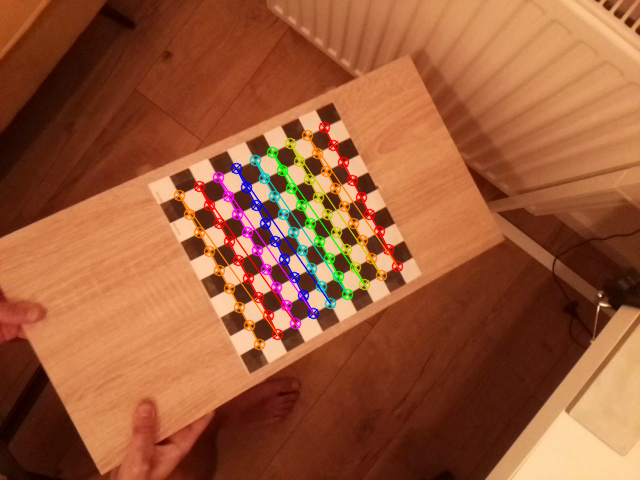

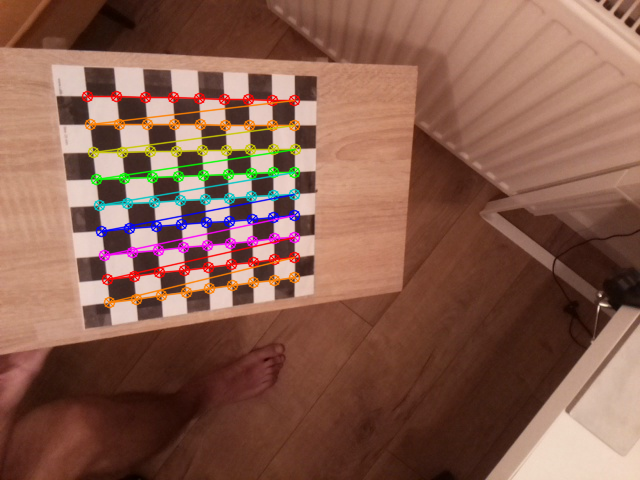

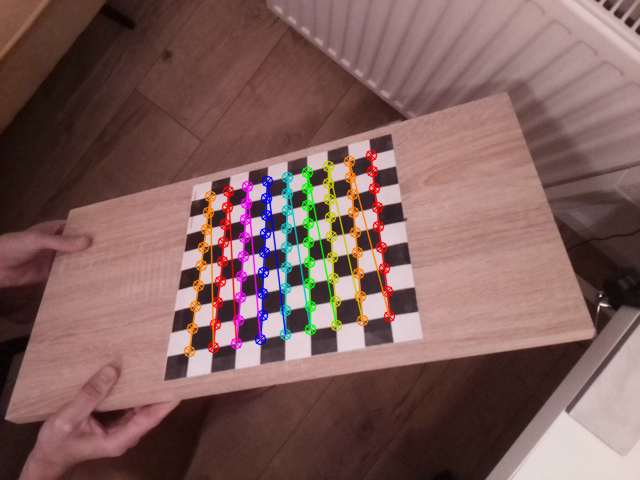

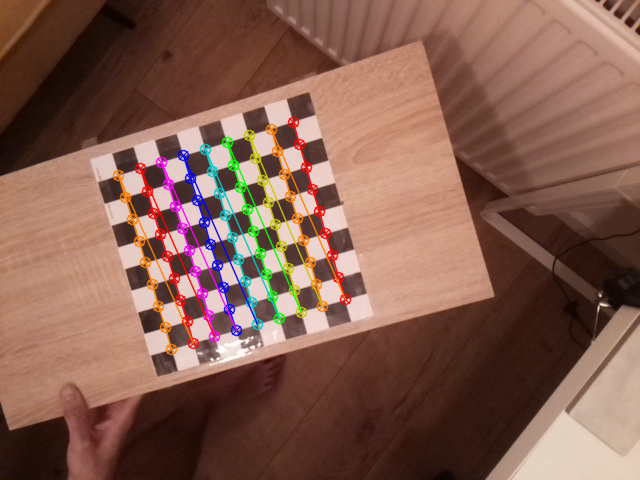

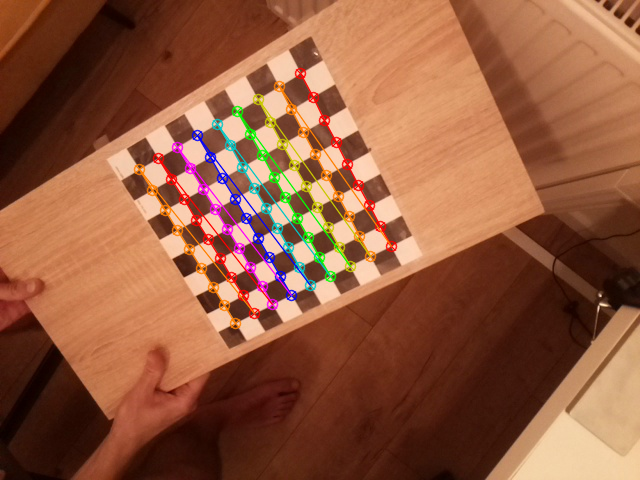

...

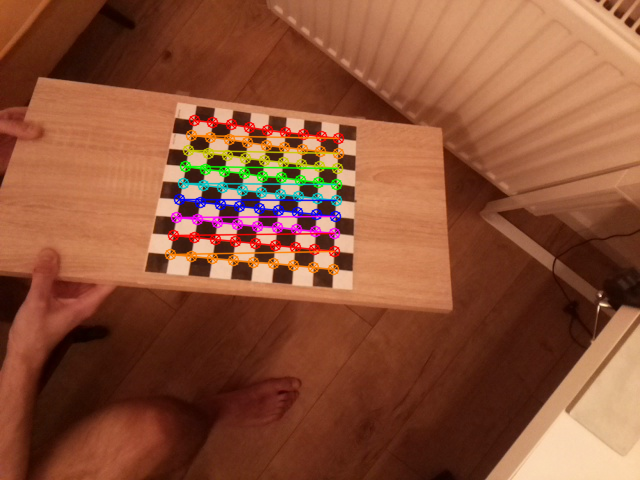

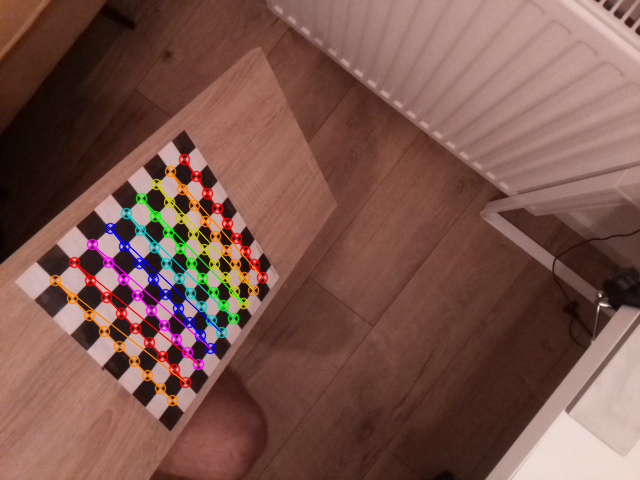

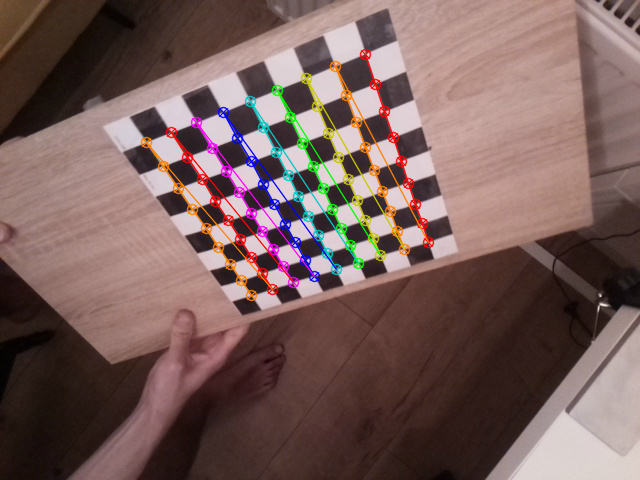

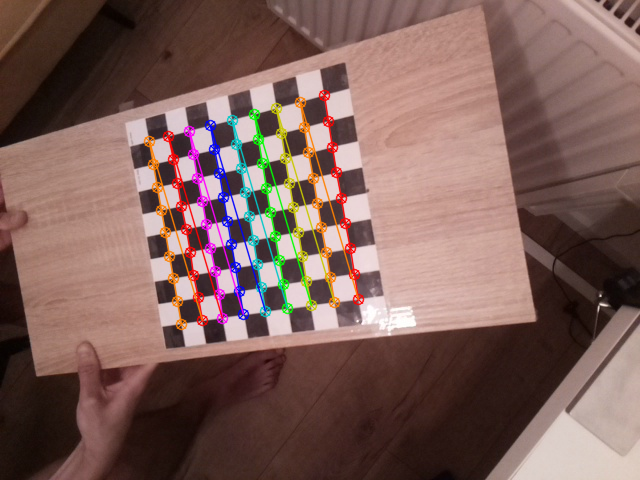

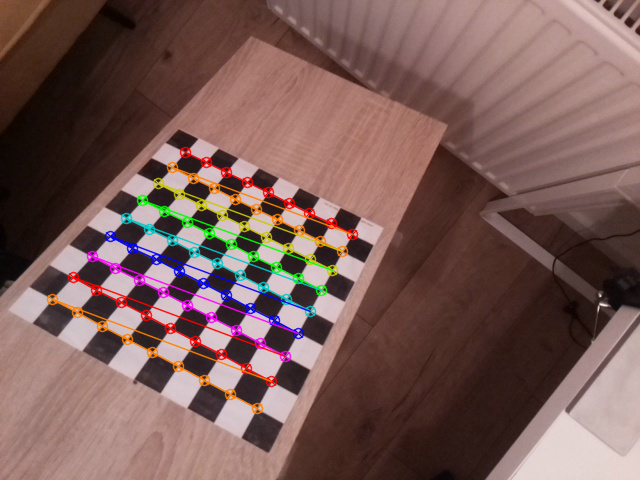

Macierz kamery (mtx):
 [[504.27569085   0.         321.14686652]
 [  0.         504.25709983 250.90746025]
 [  0.           0.           1.        ]]
Współczynniki zniekształceń (dist):
 [[ 0.18183136 -0.29152863  0.00247659  0.00436188 -0.09306431]]


In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import glob

# Wymiary szachownicy (ilość wewnątrz-1, wymiar pola w mm)
pattern_size = (9, 9)
square_size = 25  # mm

# Przygotowanie punktów wzorcowych na szachownicy
objp = np.zeros((np.prod(pattern_size), 3), dtype=np.float32)
objp[:, :2] = np.mgrid[0:pattern_size[0], 0:pattern_size[1]].T.reshape(-1, 2) * square_size

# Tablice do przechowywania punktów obrazowych i wzorcowych z wszystkich obrazów
objpoints = []  # punkty wzorcowe (3D w przestrzeni)
imgpoints = []  # punkty obrazowe (2D na obrazie)

# Znalezienie plików obrazów szachownicy
images = glob.glob('/content/ok/ok/*.jpg')

# Przetwarzanie każdego obrazu
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Wykrywanie punktów na szachownicy
    ret, corners = cv2.findChessboardCorners(gray, pattern_size, None)

    # Jeśli znaleziono wzorzec, dodaj punkty do list
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Rysowanie punktów na obrazie (opcjonalne)
        img = cv2.drawChessboardCorners(img, pattern_size, corners, ret)
        cv2_imshow(img)
        cv2.waitKey(500)  # Wyświetlenie obrazu przez 500 ms

# Kalibracja kamery
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

# Zapisanie wyników kalibracji do pliku
np.savez('calibration_data.npz', mtx=mtx, dist=dist, rvecs=rvecs, tvecs=tvecs)

# Wypisanie wyników
print("Macierz kamery (mtx):\n", mtx)
print("Współczynniki zniekształceń (dist):\n", dist)


### **2.3. Zapisanie zdjęć z wykrytymi konturami na szachownicy oraz współczynników do pliku txt**

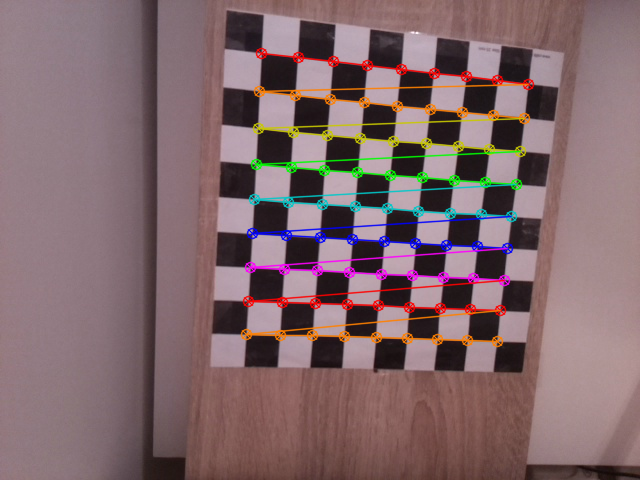

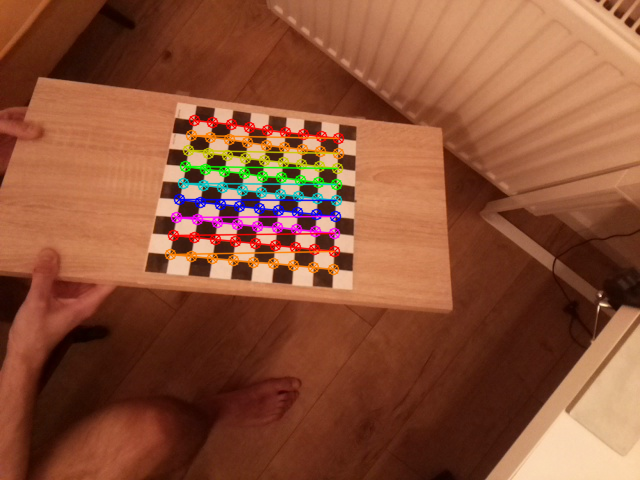

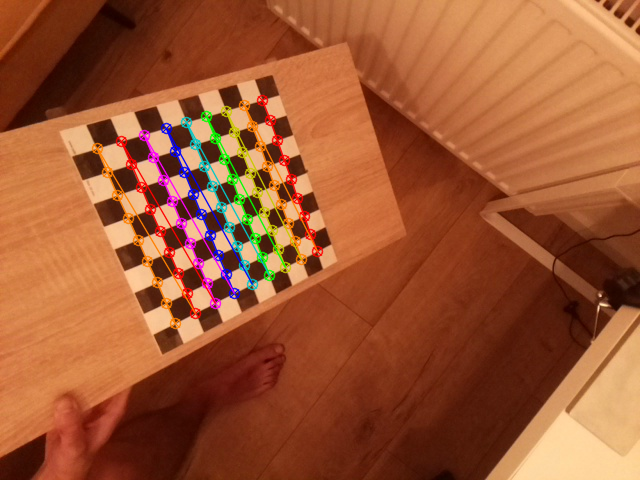

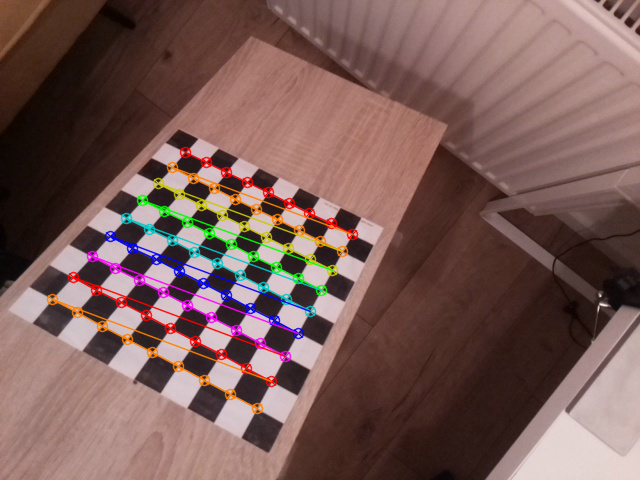

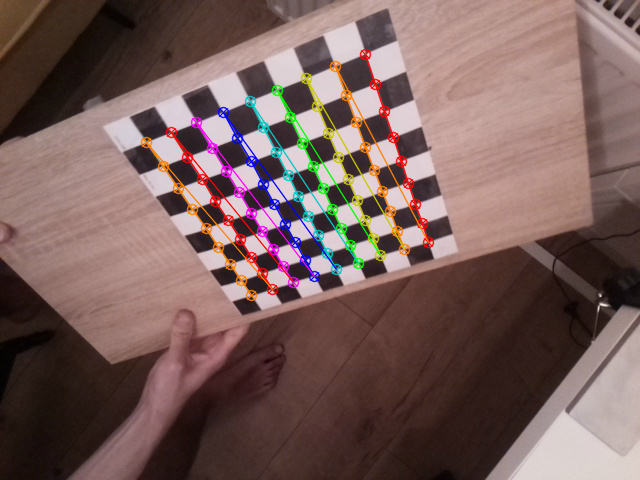

...

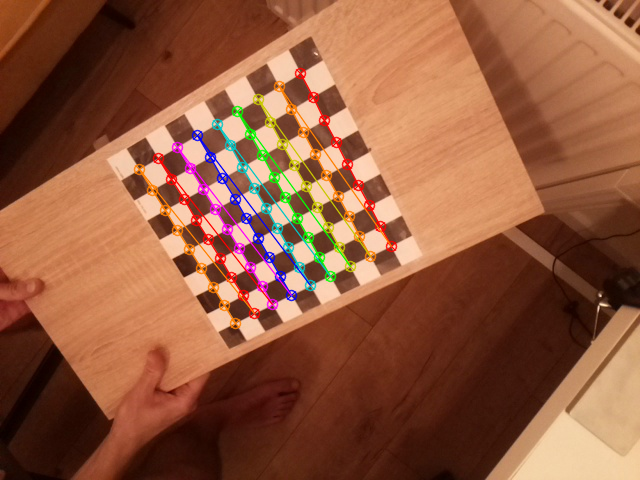

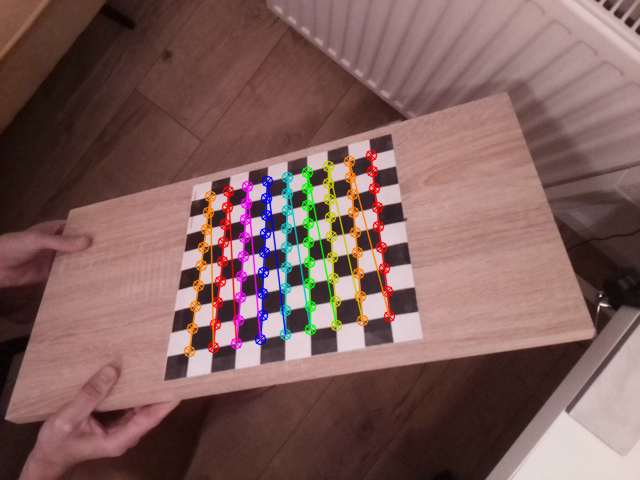

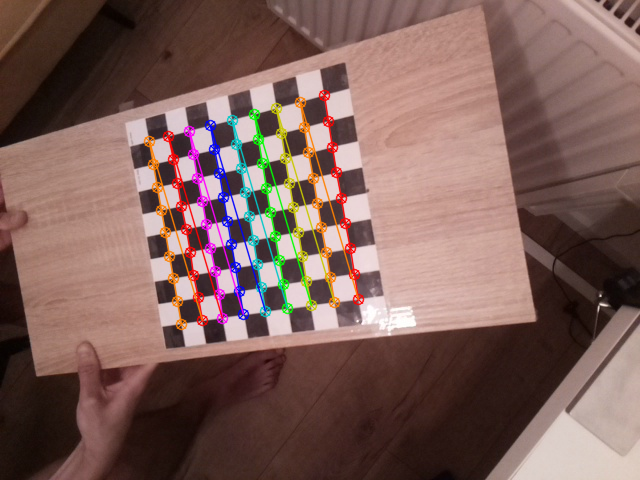

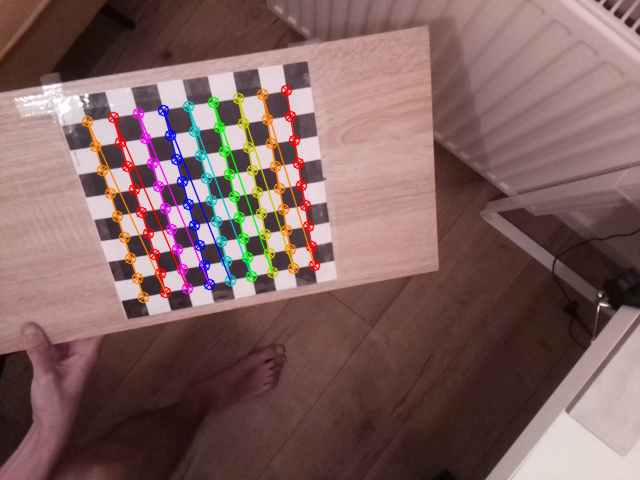

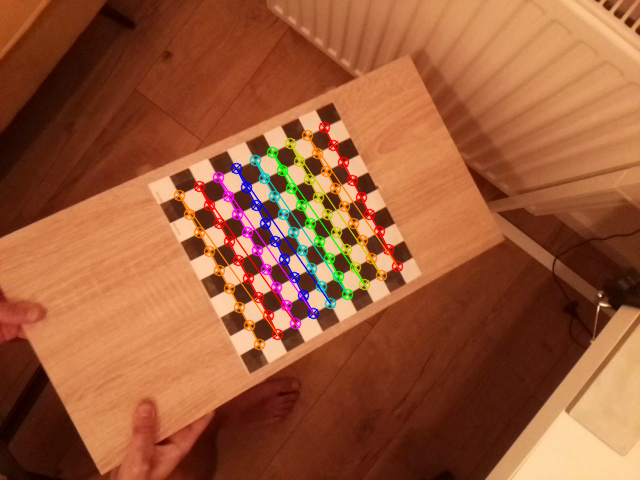

Zapisano wyniki kalibracji do pliku 'calibration_data.npz' oraz 'camera_calibration.txt'.


In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import glob

# Wymiary szachownicy (ilość wewnątrz-1, wymiar pola w mm)
pattern_size = (9, 9)
square_size = 25  # mm

# Przygotowanie punktów wzorcowych na szachownicy
objp = np.zeros((np.prod(pattern_size), 3), dtype=np.float32)
objp[:, :2] = np.mgrid[0:pattern_size[0], 0:pattern_size[1]].T.reshape(-1, 2) * square_size

# Tablice do przechowywania punktów obrazowych i wzorcowych z wszystkich obrazów
objpoints = []  # punkty wzorcowe (3D w przestrzeni)
imgpoints = []  # punkty obrazowe (2D na obrazie)

# Znalezienie plików obrazów szachownicy
images = glob.glob('/content/ok/ok/*.jpg')

# Przetwarzanie każdego obrazu
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Wykrywanie punktów na szachownicy
    ret, corners = cv2.findChessboardCorners(gray, pattern_size, None)

    # Jeśli znaleziono wzorzec, dodaj punkty do list
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Rysowanie punktów na obrazie (opcjonalne)
        img = cv2.drawChessboardCorners(img, pattern_size, corners, ret)
        cv2_imshow(img)
        cv2.waitKey(500)  # Wyświetlenie obrazu przez 500 ms

cv2.destroyAllWindows()

# Kalibracja kamery
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

# Zapisanie wyników kalibracji do pliku numpy
np.savez('calibration_data.npz', mtx=mtx, dist=dist, rvecs=rvecs, tvecs=tvecs)

# Zapisanie macierzy kamery i współczynnika zniekształceń do pliku tekstowego
with open('camera_calibration.txt', 'w') as f:
    f.write("Macierz kamery (mtx):\n")
    f.write(str(mtx) + "\n\n")
    f.write("Współczynniki zniekształceń (dist):\n")
    f.write(str(dist) + "\n")

# Wypisanie wyników
print("Zapisano wyniki kalibracji do pliku 'calibration_data.npz' oraz 'camera_calibration.txt'.")


### **2.4. Wyświetlanie zdjęć przed i po kalibracji**

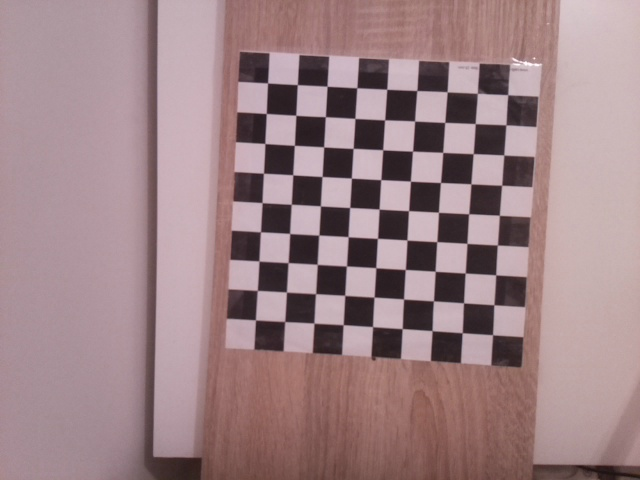

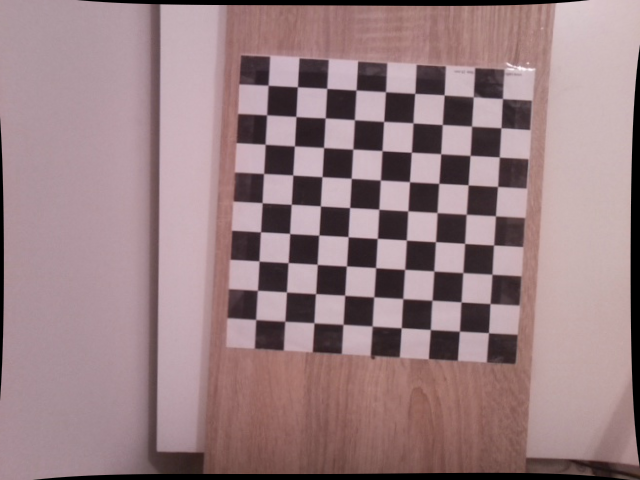

True

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

# Wczytanie obrazu do korekcji
img_path = '/content/ok/ok/image_1.jpg'
img = cv2.imread(img_path)

# Wczytanie danych kalibracji kamery
calibration_data = np.load('calibration_data.npz')
mtx = calibration_data['mtx']
dist = calibration_data['dist']

# Korekcja zniekształceń obrazu
img_corrected = cv2.undistort(img, mtx, dist)

# Wyświetlenie obrazów (opcjonalnie)
cv2_imshow(img)
cv2_imshow(img_corrected)

# Zapisanie obrazu skorygowanego (opcjonalnie)
cv2.imwrite('/content/ok/ok/image_1_corrected.jpg', img_corrected)


### **2.5. Porównanie zdjęć przed i po kalibracji**

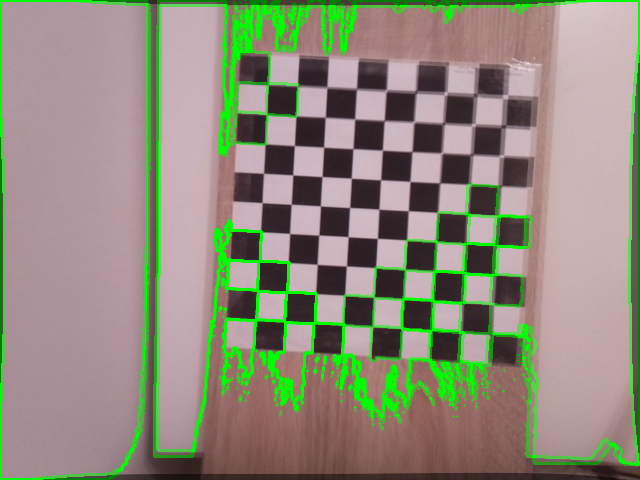

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np

def overlay_images(img1, img2, alpha=0.5):
    """
    Nałóż dwa obrazy na siebie z podanym współczynnikiem przezroczystości (alpha).

    Args:
    - img1 (numpy array): Pierwszy obraz (np. wczytany za pomocą cv2.imread()).
    - img2 (numpy array): Drugi obraz (np. wczytany za pomocą cv2.imread()).
    - alpha (float): Współczynnik przezroczystości (0.0 - całkowicie przeźroczysty, 1.0 - całkowicie nieprzezroczysty).

    Returns:
    - overlay (numpy array): Obraz wynikowy, nałożony na siebie obrazy.
    """
    overlay = cv2.addWeighted(img1, alpha, img2, 1 - alpha, 0)
    return overlay

# Przykład użycia:
if __name__ == "__main__":
    # Wczytanie obrazów
    img_path1 = '/content/ok/ok/image_1.jpg'
    img_path2 = '/content/ok/ok/image_1_corrected.jpg'
    img1 = cv2.imread(img_path1)
    img2 = cv2.imread(img_path2)

    # Nałożenie obrazów
    overlay = overlay_images(img1, img2)

    # Wyświetlenie obrazu wynikowego
    cv2_imshow(overlay)

    # Zapisanie obrazu wynikowego
    cv2.imwrite('/content/ok/ok/image_overlay.jpg', overlay)


# **03.07.2024 - Kalibracja kamery plus aruco markery**

## **1.Wykrywanie elementów plus aruco markers oraz dodana kalibracja**

Aruco 139 - początek układu współrzędnych
Aruco 677 - koniec układu współrzędnych

In [ ]:
import cv2
import numpy as np
import time
from imutils.video import WebcamVideoStream
import imutils

# Ustawienie kamery
cap = cv2.VideoCapture(0)

if not cap.isOpened():
    print("Nie udało się otworzyć kamery")
    exit()

# Macierz kamery i współczynniki zniekształceń
mtx = np.array([[504.27569085, 0., 321.14686652],
                [0., 504.25709983, 250.90746025],
                [0., 0., 1.]])
dist = np.array([[0.18183136, -0.29152863, 0.00247659, 0.00436188, -0.09306431]])

# Inicjalizacja poprzednich pozycji centroidów, historii punktów i czasu stabilności
previous_centroids = []
history_points = []
stable_since = []  # Lista przechowująca czasy stabilności dla każdego elementu
stability_threshold = 1  # Czas w sekundach, przez który pozycja musi być stabilna

# Inicjalizacja zmiennej czasu dla wyświetlania współrzędnych
last_time = time.time()

# ArUco setup
ARUCO_DICT = {
    "DICT_4X4_50": cv2.aruco.DICT_4X4_50,
    "DICT_4X4_100": cv2.aruco.DICT_4X4_100,
    "DICT_4X4_250": cv2.aruco.DICT_4X4_250,
    "DICT_4X4_1000": cv2.aruco.DICT_4X4_1000,
    "DICT_5X5_50": cv2.aruco.DICT_5X5_50,
    "DICT_5X5_100": cv2.aruco.DICT_5X5_100,
    "DICT_5X5_250": cv2.aruco.DICT_5X5_250,
    "DICT_5X5_1000": cv2.aruco.DICT_5X5_1000,
    "DICT_6X6_50": cv2.aruco.DICT_6X6_50,
    "DICT_6X6_100": cv2.aruco.DICT_6X6_100,
    "DICT_6X6_250": cv2.aruco.DICT_6X6_250,
    "DICT_6X6_1000": cv2.aruco.DICT_6X6_1000,
    "DICT_7X7_50": cv2.aruco.DICT_7X7_50,
    "DICT_7X7_100": cv2.aruco.DICT_7X7_100,
    "DICT_7X7_250": cv2.aruco.DICT_7X7_250,
    "DICT_7X7_1000": cv2.aruco.DICT_7X7_1000,
    "DICT_ARUCO_ORIGINAL": cv2.aruco.DICT_ARUCO_ORIGINAL,
}

aruco_type = [
    "DICT_4X4_50", "DICT_4X4_100", "DICT_4X4_250",
    "DICT_4X4_1000", "DICT_5X5_50", "DICT_5X5_100", "DICT_5X5_250",
    "DICT_5X5_1000", "DICT_6X6_50", "DICT_6X6_100", "DICT_6X6_250",
    "DICT_6X6_1000", "DICT_7X7_50", "DICT_7X7_100",
    "DICT_7X7_250", "DICT_7X7_1000", "DICT_ARUCO_ORIGINAL"
]

def aruco_display(corners, ids, rejected, image):
    if len(corners) > 0:
        ids = ids.flatten()
        for (markerCorner, markerID) in zip(corners, ids):
            corners = markerCorner.reshape((4, 2))
            (topLeft, topRight, bottomRight, bottomLeft) = corners

            topRight = (int(topRight[0]), int(topRight[1]))
            bottomRight = (int(bottomRight[0]), int(bottomRight[1]))
            bottomLeft = (int(bottomLeft[0]), int(bottomLeft[1]))
            topLeft = (int(topLeft[0]), int(topLeft[1]))

            cv2.line(image, topLeft, topRight, (0, 255, 0), 2)
            cv2.line(image, topRight, bottomRight, (0, 255, 0), 2)
            cv2.line(image, bottomRight, bottomLeft, (0, 255, 0), 2)
            cv2.line(image, bottomLeft, topLeft, (0, 255, 0), 2)

            cX = int((topLeft[0] + bottomRight[0]) / 2.0)
            cY = int((topLeft[1] + bottomRight[1]) / 2.0)
            cv2.circle(image, (cX, cY), 4, (0, 0, 255), -1)

            cv2.putText(image, str(markerID), (topLeft[0], topLeft[1] - 10), cv2.FONT_HERSHEY_SIMPLEX,
                        0.5, (0, 255, 0), 2)
            print("[Inference] ArUco marker ID: {}".format(markerID))

            print(cX)
            print(cY)

    return image

while True:
    # Wczytaj obraz z kamery
    ret, frame = cap.read()

    # Sprawdź, czy obraz został wczytany poprawnie
    if not ret:
        print("Nie udało się wczytać klatki z kamery")
        break

    # Undistort the frame
    frame_undistorted = cv2.undistort(frame, mtx, dist, None, mtx)

    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(frame_undistorted, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    result = cv2.bitwise_and(frame_undistorted, frame_undistorted, mask=mask)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Odsiewanie małych konturów
    min_contour_area = 500  # Minimalna powierzchnia konturu, aby go zachować
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) >= min_contour_area]

    # Rysowanie konturów na oryginalnym obrazie
    contoured_image = frame_undistorted.copy()
    cv2.drawContours(contoured_image, filtered_contours, -1, (0, 255, 0), 3)  # Rysowanie konturów kolorem zielonym

    # Obliczanie środków elementów i ich powierzchni
    centroids = []
    areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids.append((cX, cY))
            areas.append(cv2.contourArea(cnt))
            # Dodanie etykiety z kolorem
            cv2.putText(contoured_image, 'Niebieski', (cX - 50, cY - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
        else:
            centroids.append((0, 0))
            areas.append(0)

    # Zakładamy, że mniejszy element ma rzeczywiste wymiary 1x1 a większy 2x2
    if len(areas) == 2:
        min_area = min(areas)
        max_area = max(areas)
        scale_factor = np.sqrt(max_area / min_area)  # Stosunek skalowania

        # Odległość między środkami elementów w pikselach
        distance_pixels = np.linalg.norm(np.array(centroids[0]) - np.array(centroids[1]))

        # Skalowanie odległości na podstawie rzeczywistych wymiarów
        distance_real = distance_pixels / scale_factor

        # Wyświetlanie wyników
        print(f"Odległość między środkami elementów w pikselach: {distance_pixels:.2f}")
        print(f"Szacowana odległość rzeczywista między elementami: {distance_real:.2f}")

    # Sprawdzenie stabilności i zapisywanie punktów, jeśli pozycja jest stabilna przez 1 sekundę
    current_time = time.time()
    if previous_centroids:
        for i, (prev, curr) in enumerate(zip(previous_centroids, centroids)):
            if prev != curr:
                # Zaktualizuj czas ostatniej zmiany pozycji
                if i < len(stable_since):
                    stable_since[i] = current_time
                else:
                    stable_since.append(current_time)
            else:
                # Sprawdź, czy pozycja jest stabilna przez wystarczająco długi czas
                if i < len(stable_since) and current_time - stable_since[i] >= stability_threshold:
                    # Dodaj punkt do historii, jeśli jest stabilny przez 1 sekundę
                    if len(history_points) == 0 or history_points[-1][0] != curr:
                        history_points.append((curr, len(history_points) + 1))
                    stable_since[i] = current_time  # Zresetuj czas stabilności

    # Rysowanie linii przemieszczenia, jeśli pozycje się zmieniły
    if previous_centroids:
        for prev, curr in zip(previous_centroids, centroids):
            if prev != curr:
                cv2.line(contoured_image, prev, curr, (0, 0, 255), 2)  # Rysowanie czerwonej linii

    # Rysowanie wszystkich punktów z historii
    for point, index in history_points:
        cv2.circle(contoured_image, point, 5, (0, 0, 255), -1)  # Rysowanie kropki
        cv2.putText(contoured_image, str(index), (point[0] + 10, point[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

    # Zaktualizuj poprzednie centroids
    previous_centroids = centroids.copy()

    # Wyświetlanie aktualnych koordynatów co 5 sekund
    if current_time - last_time >= 5:
        last_time = current_time
        print("Aktualne koordynaty:")
        for i, (cX, cY) in enumerate(centroids):
            print(f"Element {i+1}: ({cX}, {cY})")

    # Detekcja markerów ArUco
    for i in aruco_type:
        arucoDict = cv2.aruco.getPredefinedDictionary(ARUCO_DICT[i])
        arucoParams = cv2.aruco.DetectorParameters()
        detector = cv2.aruco.ArucoDetector(arucoDict, arucoParams)
        corners, ids, rejected = detector.detectMarkers(contoured_image)
        detected_markers = aruco_display(corners, ids, rejected, contoured_image)

    # Wyświetlanie obrazu z naniesionymi konturami, liniami przemieszczenia, punktami i markerami ArUco
    cv2.imshow('Kontury na oryginalnym obrazie', detected_markers)

    # Zakończenie działania po naciśnięciu klawisza 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Zwolnienie zasobów
cap.release()
cv2.destroyAllWindows()


## **2. Przekształcenie układu na kartezjanski**

Aruco 139 - początek układu współrzędnych
Aruco 677 - koniec układu współrzędnych

In [ ]:

import cv2
import numpy as np
import time

# Ustawienie kamery
cap = cv2.VideoCapture(0)

if not cap.isOpened():
    print("Nie udało się otworzyć kamery")
    exit()

# Macierz kamery i współczynniki zniekształceń
mtx = np.array([[504.27569085, 0., 321.14686652],
                [0., 504.25709983, 250.90746025],
                [0., 0., 1.]])
dist = np.array([[0.18183136, -0.29152863, 0.00247659, 0.00436188, -0.09306431]])

# Inicjalizacja poprzednich pozycji centroidów, historii punktów i czasu stabilności
previous_centroids = []
history_points = []
stable_since = []  # Lista przechowująca czasy stabilności dla każdego elementu
stability_threshold = 1  # Czas w sekundach, przez który pozycja musi być stabilna

# Inicjalizacja zmiennych dla markerów ArUco
previous_aruco_positions = None  # Poprzednie pozycje markerów ArUco
aruco_positions_displayed = False  # Flaga, czy już wyświetlono pozycje markerów ArUco

# Inicjalizacja zmiennej czasu dla wyświetlania współrzędnych
last_time = time.time()

# Wymiary przestrzeni dla markerów ArUco (180x180 mm)
aruco_space_mm = 180  # Rozmiar przestrzeni w milimetrach


# ArUco setup
ARUCO_DICT = {
    "DICT_4X4_50": cv2.aruco.DICT_4X4_50,
    "DICT_4X4_100": cv2.aruco.DICT_4X4_100,
    "DICT_4X4_250": cv2.aruco.DICT_4X4_250,
    "DICT_4X4_1000": cv2.aruco.DICT_4X4_1000,
    "DICT_5X5_50": cv2.aruco.DICT_5X5_50,
    "DICT_5X5_100": cv2.aruco.DICT_5X5_100,
    "DICT_5X5_250": cv2.aruco.DICT_5X5_250,
    "DICT_5X5_1000": cv2.aruco.DICT_5X5_1000,
    "DICT_6X6_50": cv2.aruco.DICT_6X6_50,
    "DICT_6X6_100": cv2.aruco.DICT_6X6_100,
    "DICT_6X6_250": cv2.aruco.DICT_6X6_250,
    "DICT_6X6_1000": cv2.aruco.DICT_6X6_1000,
    "DICT_7X7_50": cv2.aruco.DICT_7X7_50,
    "DICT_7X7_100": cv2.aruco.DICT_7X7_100,
    "DICT_7X7_250": cv2.aruco.DICT_7X7_250,
    "DICT_7X7_1000": cv2.aruco.DICT_7X7_1000,
    "DICT_ARUCO_ORIGINAL": cv2.aruco.DICT_ARUCO_ORIGINAL,
}

aruco_type = [
    "DICT_4X4_50", "DICT_4X4_100", "DICT_4X4_250",
    "DICT_4X4_1000", "DICT_5X5_50", "DICT_5X5_100", "DICT_5X5_250",
    "DICT_5X5_1000", "DICT_6X6_50", "DICT_6X6_100", "DICT_6X6_250",
    "DICT_6X6_1000", "DICT_7X7_50", "DICT_7X7_100",
    "DICT_7X7_250", "DICT_7X7_1000", "DICT_ARUCO_ORIGINAL"
]

def aruco_display(corners, ids, rejected, image):
	if len(corners) > 0:

		ids = ids.flatten()

		for (markerCorner, markerID) in zip(corners, ids):

			corners = markerCorner.reshape((4, 2))
			(topLeft, topRight, bottomRight, bottomLeft) = corners

			topRight = (int(topRight[0]), int(topRight[1]))
			bottomRight = (int(bottomRight[0]), int(bottomRight[1]))
			bottomLeft = (int(bottomLeft[0]), int(bottomLeft[1]))
			topLeft = (int(topLeft[0]), int(topLeft[1]))

			cv2.line(image, topLeft, topRight, (0, 255, 0), 2)
			cv2.line(image, topRight, bottomRight, (0, 255, 0), 2)
			cv2.line(image, bottomRight, bottomLeft, (0, 255, 0), 2)
			cv2.line(image, bottomLeft, topLeft, (0, 255, 0), 2)

			cX = int((topLeft[0] + bottomRight[0]) / 2.0)
			cY = int((topLeft[1] + bottomRight[1]) / 2.0)
			cv2.circle(image, (cX, cY), 4, (0, 0, 255), -1)

			cv2.putText(image, str(markerID),(topLeft[0], topLeft[1] - 10), cv2.FONT_HERSHEY_SIMPLEX,
				0.5, (0, 255, 0), 2)
			print("[Inference] ArUco marker ID: {}".format(markerID))

      cv2.putText(image, (cX,cY), (topLeft[0], topLeft[1] - 10), cv2.FONT_HERSHEY_SIMPLEX,
        0.5, (0, 255, 0), 2)
      print("[Inference] ArUco marker ID: {}".format(markerID))

	return image

def estimate_real_position(marker_id, marker_spacing_mm=180):
    # Przeliczenie na rzeczywiste współrzędne na podstawie ID markera ArUco
    rows = 4  # liczba linii
    columns = 5  # liczba kolumn
    marker_size = 0.180  # rozmiar markera w metrach
    row = marker_id // columns
    column = marker_id % columns
    real_x = (column * marker_size) - (marker_spacing_mm / 2.0)
    real_y = (row * marker_size) - (marker_spacing_mm / 2.0)
    return real_x, real_y

while True:
    # Wczytaj obraz z kamery
    ret, frame = cap.read()

    # Sprawdź, czy obraz został wczytany poprawnie
    if not ret:
        print("Nie udało się wczytać klatki z kamery")
        break

    # Undistort the frame
    frame_undistorted = cv2.undistort(frame, mtx, dist, None, mtx)

    # Konwertuj obraz do przestrzeni HSV
    hsv_image = cv2.cvtColor(frame_undistorted, cv2.COLOR_BGR2HSV)

    # Definiowanie zakresów kolorów
    lower_blue = np.array([100, 100, 50])
    upper_blue = np.array([140, 255, 255])

    # Utworzenie maski na podstawie zakresów kolorów
    mask = cv2.inRange(hsv_image, lower_blue, upper_blue)
    mask = cv2.medianBlur(mask, 5)

    # Znajdowanie konturów
    contours, _ = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # Filtrowanie konturów
    filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) > 100]

    # Tworzenie obrazu z naniesionymi konturami
    contoured_image = frame_undistorted.copy()
    cv2.drawContours(contoured_image, filtered_contours, -1, (255, 0, 0), 2)

    # Przetwarzanie centroidów i obszarów konturów
    centroids = []
    areas = []
    for cnt in filtered_contours:
        M = cv2.moments(cnt)
        if M['m00'] != 0:
            cX = int(M['m10'] / M['m00'])
            cY = int(M['m01'] / M['m00'])
            centroids.append((cX, cY))
            areas.append(cv2.contourArea(cnt))
            cv2.putText(contoured_image, 'Niebieski', (cX - 50, cY - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
        else:
            centroids.append((0, 0))
            areas.append(0)

    # Sprawdzenie stabilności i zapisywanie punktów, jeśli pozycja jest stabilna przez 1 sekundę
    current_time = time.time()
    if previous_centroids:
        for i, (prev, curr) in enumerate(zip(previous_centroids, centroids)):
            if prev != curr:
                if i < len(stable_since):
                    stable_since[i] = current_time
                else:
                    stable_since.append(current_time)
            else:
                if i < len(stable_since) and current_time - stable_since[i] >= stability_threshold:
                    if len(history_points) == 0 or history_points[-1][0] != curr:
                        history_points.append((curr, len(history_points) + 1))
                    stable_since[i] = current_time

    # Rysowanie linii przemieszczenia, jeśli pozycje się zmieniły
    if previous_centroids:
        for prev, curr in zip(previous_centroids, centroids):
            if prev != curr:
                cv2.line(contoured_image, prev, curr, (0, 0, 255), 2)

    # Rysowanie wszystkich punktów z historii
    for point, index in history_points:
        cv2.circle(contoured_image, point, 5, (0, 0, 255), -1)
        cv2.putText(contoured_image, str(index), (point[0] + 10, point[1]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

    # Aktualizacja poprzednich centroidów
    previous_centroids = centroids.copy()

    # Wyświetlanie aktualnych koordynatów co 5 sekund
    if current_time - last_time >= 5:
        last_time = current_time
        print("Aktualne koordynaty:")
        for i, (cX, cY) in enumerate(centroids):
            real_pos = estimate_real_position(cX, cY)
            print(f"Element {i+1}: ({cX}, {cY}) - Szacowane rzeczywiste: ({real_pos[0]:.2f} m, {real_pos[1]:.2f} m)")

    # Detekcja markerów ArUco
    for i in aruco_type:
        arucoDict = cv2.aruco.getPredefinedDictionary(ARUCO_DICT[i])
        arucoParams = cv2.aruco.DetectorParameters()
        detector = cv2.aruco.ArucoDetector(arucoDict, arucoParams)
        corners, ids, rejected = detector.detectMarkers(contoured_image)

        if corners is not None and ids is not None:
            detected_markers = aruco_display(corners, ids, rejected, contoured_image)

            current_aruco_positions = [(np.mean(corner[:, 0]), np.mean(corner[:, 1])) for corner in corners]
            if previous_aruco_positions is not None and previous_aruco_positions == current_aruco_positions:
                continue

            previous_aruco_positions = current_aruco_positions

            cv2.imshow('Kontury na oryginalnym obrazie', detected_markers)

    # Zakończenie programu po naciśnięciu 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Zwolnienie zasobów
cap.release()
cv2.destroyAllWindows()